<a href="https://colab.research.google.com/github/danielav081596/Proyecto_Integrador_Equipo5/blob/main/Avance4_Equipo_5_Final_re_load.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


#**Instituto Tecnológico y de Estudios Superiores de Monterrey**

##**Maestría en Inteligencia Artificial Aplicada**

### TC5035.10 Proyecto Integrador - "Modelación y predicción del impacto de las experiencias benevolentes en la infancia en las Condiciones de Bienestar Emocional (BCEs) en niños y adultos mexicanos"


#### Dra. Grettel Barceló Alonso - Asesor del proyecto

*Avance 4. Modelos alternativos*


**Equipo # 5**
* Karla Daniela Valenzuela A00819192
* Emmanuel Domínguez Bravo A01793683


In [ ]:
#!pip install pyreadstat

In [ ]:
!pip install feature-engine

In [ ]:
!pip install prince

In [ ]:
!pip install sweetviz

In [ ]:
# importamos las librerías requeridas

import numpy as np
import pandas as pd
#import pyreadstat
import matplotlib.pyplot as plt
import seaborn as sns
import sweetviz as sv
from tabulate import tabulate
from sklearn.feature_selection import chi2

from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
#from sklearn.preprocessing import OrdinalEncoder
from scipy.stats import boxcox
from sklearn.compose import ColumnTransformer
from sklearn.dummy import DummyClassifier
from sklearn.preprocessing import power_transform
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import KFold

from sklearn.impute import SimpleImputer
from sklearn.preprocessing import MinMaxScaler, FunctionTransformer#, OneHotEncoder
from feature_engine.encoding import OrdinalEncoder
from feature_engine.encoding import OneHotEncoder
from scipy.stats import chi2_contingency
from sklearn.feature_selection import chi2


from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold

from sklearn.model_selection import validation_curve
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import learning_curve, validation_curve

from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score
from sklearn.metrics import confusion_matrix
from numpy.core.function_base import linspace
from sklearn.metrics import classification_report

from sklearn.decomposition import PCA
from sklearn.feature_selection import mutual_info_regression
from sklearn.model_selection import cross_val_score
from xgboost import XGBRegressor

from imblearn.under_sampling import TomekLinks
from imblearn.under_sampling import EditedNearestNeighbours

from imblearn.over_sampling import SMOTE

from imblearn.combine import SMOTEENN
from imblearn.combine import SMOTETomek
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler


from sklearn.metrics import classification_report, make_scorer, recall_score
from imblearn.metrics import geometric_mean_score, classification_report_imbalanced
from sklearn.model_selection import cross_val_score, cross_validate, RepeatedStratifiedKFold


In [ ]:
! git clone https://github.com/danielav081596/Proyecto_Integrador_Equipo5.git

fatal: destination path 'Proyecto_Integrador_Equipo5' already exists and is not an empty directory.


In [ ]:
# Creamos un dataframe del archivo .csv

df_adultos = pd.read_csv('/content/Proyecto_Integrador_Equipo5/ACEs Adultos.csv', encoding='latin1')


In [ ]:
# La base de datos tiene 689 columnas:

df_adultos.head()

,FOLIO,FOLIO2,ID_ADULTO,TELEFONO,CORREO,BINOMIO,FILTRO,ENT,ENTIDAD,MUN,...,EDAD,INDIGENA,RELIGION,ESCOLARIDAD,NSEF,NSE5F,UPM,RURAL,PONDERADOR,AREA
0,0100108639999001-01,0100108639999001-01,1.0,4.493858e+09,yeimider1@gmail.com,1,2,1,AGUASCALIENTES,1,...,26.0,2.0,1.0,2.0,3.0,5.0,0100108639999,1.0,18619.783203,1.0
1,0100108639999001-02,0100108639999001-02,3.0,4.495684e+09,NaN,0,2,1,AGUASCALIENTES,1,...,32.0,2.0,1.0,2.0,3.0,5.0,0100108639999,1.0,18619.783203,1.0
2,0100108639999001-03,0100108639999001-03,1.0,4.494059e+09,Betomartiez89@gmail.com,1,2,1,AGUASCALIENTES,1,...,30.0,2.0,1.0,2.0,3.0,5.0,0100108639999,1.0,18619.783203,1.0
3,0100108639999001-04,0100108639999001-04,1.0,4.496682e+09,NaN,1,2,1,AGUASCALIENTES,1,...,26.0,2.0,1.0,2.0,1.0,1.0,0100108639999,1.0,18619.783203,1.0
4,0100108639999001-05,0100108639999001-05,1.0,4.492521e+09,NaN,1,2,1,AGUASCALIENTES,1,...,32.0,2.0,1.0,2.0,2.0,3.0,0100108639999,1.0,18619.783203,1.0


In [ ]:
# Renombramos columnas para facilitar su identificación

survey = {'AD_M07_50':"Seguridad alimentaria 2",'AD_M07_51':"Seguridad alimentaria 3",'AD_M07_52':"Seguridad alimentaria 4",
                     'AD_M07_53':"Seguridad alimentaria 5",'AD_M07_54':"Seguridad alimentaria 6",'AD_M07_55':"Seguridad alimentaria 7",
                     'AD_M09_95_01_1':"comportamiento_riesgo 1",'AD_M09_95_01_2':"comportamiento_riesgo 2",'AD_M09_95_01_3':"comportamiento_riesgo 3",'AD_M09_95_01_4':"comportamiento_riesgo 4",
                     'AD_M09_95_02_1':"comportamiento_riesgo 5",'AD_M09_95_02_2':"comportamiento_riesgo 6",'AD_M09_95_02_3':"comportamiento_riesgo 7",'AD_M09_95_02_4':"comportamiento_riesgo 8",
                     'AD_M09_95_03_1':"comportamiento_riesgo 9",'AD_M09_95_03_2':"comportamiento_riesgo 10",'AD_M09_95_03_3':"comportamiento_riesgo 11",'AD_M09_95_03_4':"comportamiento_riesgo 12",
                     'AD_M09_95_04_1':"comportamiento_riesgo 13",'AD_M09_95_04_2':"comportamiento_riesgo 14",'AD_M09_95_04_3':"comportamiento_riesgo 15",'AD_M09_95_04_4':"comportamiento_riesgo 16",
                     'AD_M09_95_05_1':"comportamiento_riesgo 17",'AD_M09_95_05_2':"comportamiento_riesgo 18",'AD_M09_95_05_3':"comportamiento_riesgo 19",'AD_M09_95_05_4':"comportamiento_riesgo 20",
                     'AD_M09_95_06_1':"comportamiento_riesgo 21",'AD_M09_95_06_2':"comportamiento_riesgo 22",'AD_M09_95_06_3':"comportamiento_riesgo 23",'AD_M09_95_06_4':"comportamiento_riesgo 24",
                     'AD_M09_96_01_1':"Depresión_pregunta",'AD_M09_96_02_1':"Trastorno Bipolar_pregunta",'AD_M09_96_03_1':"Ezquizofrenia_pregunta",'AD_M09_96_04_1':"Estrés postrauma_pregunta",
                     'AD_M09_96_05_1':"Anorexia Nerviosa_pregunta",'AD_M09_96_06_1':"Bulimia Nerviosa_pregunta",'AD_M09_96_07_1':"Ansiedad_encuesta", 'AD_M09_96_08_1':'TRASTORNO_LÍMITE_PERSONALIDAD_pregunta',
                     'AD_M09_96_09_1':"Ideación Suicida_pregunta",'AD_M09_96_10_1':"AUTOLESIONES NO SUICIDAS_pregunta",'AD_M09_96_11_1':"DÉFICIT_ATENCIÓN_HIPERACTIVIDAD_pregunta",'AD_M09_96_12_1':"Alcoholismo",
                     'AD_M09_96_13_1':"Consumo_Sustancias_pregunta",'AD_M09_96_14_1':"Autismo_pregunta",'AD_M09_96_15_1':"Otro Trastorno",'AD_M09_97_01':"Síntomas_trastornos_1",'AD_M09_97_02':"Síntomas_trastornos_2",
                     'AD_M09_97_03':"Síntomas_trastornos_3",'AD_M09_97_04':"Síntomas_trastornos_4",'AD_M09_97_05':"Síntomas_trastornos_5",'AD_M09_97_02':"Síntomas_trastornos_2"}

df_adultos = df_adultos.rename(columns=survey)


In [ ]:
# List of columns to rename - Positive experiences
positive_att = {'AD_M10_115_01': 'Exp_pos_1','AD_M10_115_02': 'Exp_pos_2','AD_M10_115_03': 'Exp_pos_3','AD_M10_115_04': 'Exp_pos_4','AD_M10_115_05': 'Exp_pos_5',
                'AD_M10_115_06': 'Exp_pos_6','AD_M10_115_07': 'Exp_pos_7','AD_M10_115_08': 'Exp_pos_8','AD_M10_115_09': 'Exp_pos_9','AD_M10_115_10': 'Exp_pos_10',
                'AD_M10_116_01': 'Exp_pos_11','AD_M10_116_02': 'Exp_pos_12','AD_M10_116_03': 'Exp_pos_13','AD_M10_116_04': 'Exp_pos_14','AD_M10_116_05': 'Exp_pos_15',
                'AD_M10_116_06': 'Exp_pos_16','AD_M10_116_07': 'Exp_pos_17','AD_M11_117': 'Bienestar_1','AD_M11_118': 'Bienestar_2','AD_M12_120_01': 'Co_social_1',
                'AD_M12_120_02': 'Co_social_2','AD_M12_120_03': 'Co_social_3','AD_M12_120_04': 'Co_social_4','AD_M12_120_05': 'Co_social_5','AD_M12_120_06': 'Co_social_6',
                'AD_M12_120_07': 'Co_social_7','AD_M12_120_08': 'Co_social_8','AD_M12_120_09': 'Co_social_9','AD_M12_120_10': 'Co_social_10','AD_M12_120_11': 'Co_social_11',
                'AD_M12_120_12': 'Co_social_12','AD_M12_120_13': 'Co_social_13','AD_M12_120_14': 'Co_social_14','AD_M12_120_15': 'Co_social_15','AD_M12_120_16': 'Co_social_16',
                'SUM_TOTAL':'SUM_EX_POS','NIV_SEG':'NIV_SEG_ALIMENTARIA'}

In [ ]:
# Renombramos las columnas
df_adultos = df_adultos.rename(columns=positive_att)

In [ ]:
# Renombramos las respuestas de experiencias negativas (ACEs)
ACES = {'Indicador01':'ACE1','Indicador02':'ACE2','Indicador03':'ACE3',
        'Indicador04':'ACE4','Indicador05':'ACE5','Indicador06':'ACE6',
        'Indicador07':'ACE7','Indicador08':'ACE8','Indicador09':'ACE9',
        'Indicador10':'ACE10','Indicador11':'ACE11','Indicador12':'ACE12',
        'Indicador13':'ACE13'}
df_adultos=df_adultos.rename(columns=ACES)

In [ ]:
# Renombramos las variables dependientes

y_train_col = {'DxPHQ9':'Depresion', 'DxGAD7':'Ansiedad','DxPCL5':'TRANSTORNO_ESTRES POSTRAUMÁTICO','Dx_SCOFF':'SOSPECHA DE ANOREXIA/BULIMIA'}

df_adultos.rename(columns=y_train_col, inplace=True)

In [ ]:
# Definimos nuestro conjunto de datos de salida etiquetados
target_lst = ['Depresion', 'Ansiedad','TRANSTORNO_ESTRES POSTRAUMÁTICO', 'SOSPECHA DE ANOREXIA/BULIMIA']

y = df_adultos[target_lst]

df_adultos.drop(columns=target_lst, inplace=True)

In [ ]:
# Quitamos de nuestro Data Frame las preguntas que se derivan de las variables de salida

variable_lst = []
import re

variables_to_drop = ['PHQ9','GAD7','PCL5','SCOFF','AD_M13_122']

for variable_pattern in variables_to_drop:
    variable_lst.extend(list(df_adultos.columns[df_adultos.columns.str.contains(variable_pattern, regex=False)]))
df_adultos.drop(columns=variable_lst, inplace=True)

In [ ]:
# Revisamos los % de valores faltantes por columna
faltantes = (pd.isnull(df_adultos).sum()/df_adultos.shape[0])*100
faltantes = faltantes.sort_values(ascending=False)
faltantes.to_csv('faltantes V2.csv')
faltantes

AD_M09_104_18_02            100.0
comportamiento_riesgo 16    100.0
AD_M09_96_14_4              100.0
AD_M09_104_18_03            100.0
AD_M09_96_09_4              100.0
                            ...  
GPS1                          0.0
ESPANOL$01                    0.0
ACE2                          0.0
ACE3                          0.0
FOLIO                         0.0
Length: 680, dtype: float64

In [ ]:
# Removemos columnas con más de 85% de valores faltantes

threshold = 85
columns_to_keep = faltantes[faltantes <= threshold].index
df_adultos = df_adultos[columns_to_keep]

In [ ]:
# Revisamos nuevamente los % de valores faltantes por columna

faltantes = (pd.isnull(df_adultos).sum()/df_adultos.shape[0])*100
faltantes = faltantes.sort_values(ascending=False)
faltantes.head(100)

AD_M09_111_13_2             84.400545
AD_M09_111_11_2             83.378747
AD_M09_114_01               78.474114
AD_M09_114_02               78.474114
AD_M09_114_03               78.474114
                              ...    
comportamiento_riesgo 13     1.430518
Otro Trastorno               1.362398
AD_M09_101_06                1.362398
comportamiento_riesgo 17     1.226158
comportamiento_riesgo 21     1.226158
Length: 100, dtype: float64

In [ ]:
# Imputamos la moda para valores faltantes

# Replace missing values with the mode
mode_values = df_adultos.mode().iloc[0]
df_adultos = df_adultos.fillna(mode_values)


In [ ]:
# Revisamos los valores faltantes de y

faltantes = (pd.isnull(y).sum()/y.shape[0])*100
faltantes = faltantes.sort_values(ascending=False)
faltantes.head(100)

Depresion                          0.544959
Ansiedad                           0.544959
TRANSTORNO_ESTRES POSTRAUMÁTICO    0.544959
SOSPECHA DE ANOREXIA/BULIMIA       0.000000
dtype: float64

In [ ]:
from sklearn.impute import SimpleImputer

# Create a SimpleImputer instance with strategy='most_frequent' (mode)
imputer = SimpleImputer(strategy='most_frequent')

# Fit and transform the data to fill missing values
y_imputed = imputer.fit_transform(y)

# Convert back to a DataFrame
y_imputed_df = pd.DataFrame(y_imputed, columns=y.columns, index=y.index)

# Replace the original DataFrame with the imputed values
y = y_imputed_df

# EDA con SweetViz

In [ ]:
# Hacemos una copia del Data Frame obtenido para tener un respaldo rápido

df_adultos2 = df_adultos.copy()

In [ ]:
# Hacemos una exploración de los datos numéricos usando SweetViz
report_num = sv.analyze(df_adultos, pairwise_analysis='on')

                                             |          | [  0%]   00:00 -> (? left)


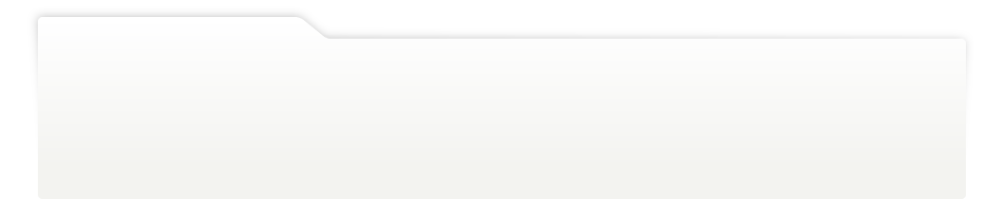
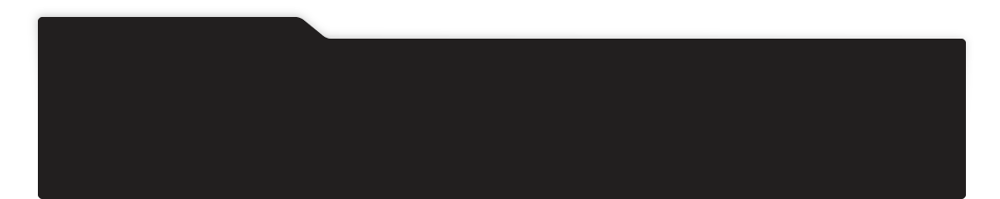
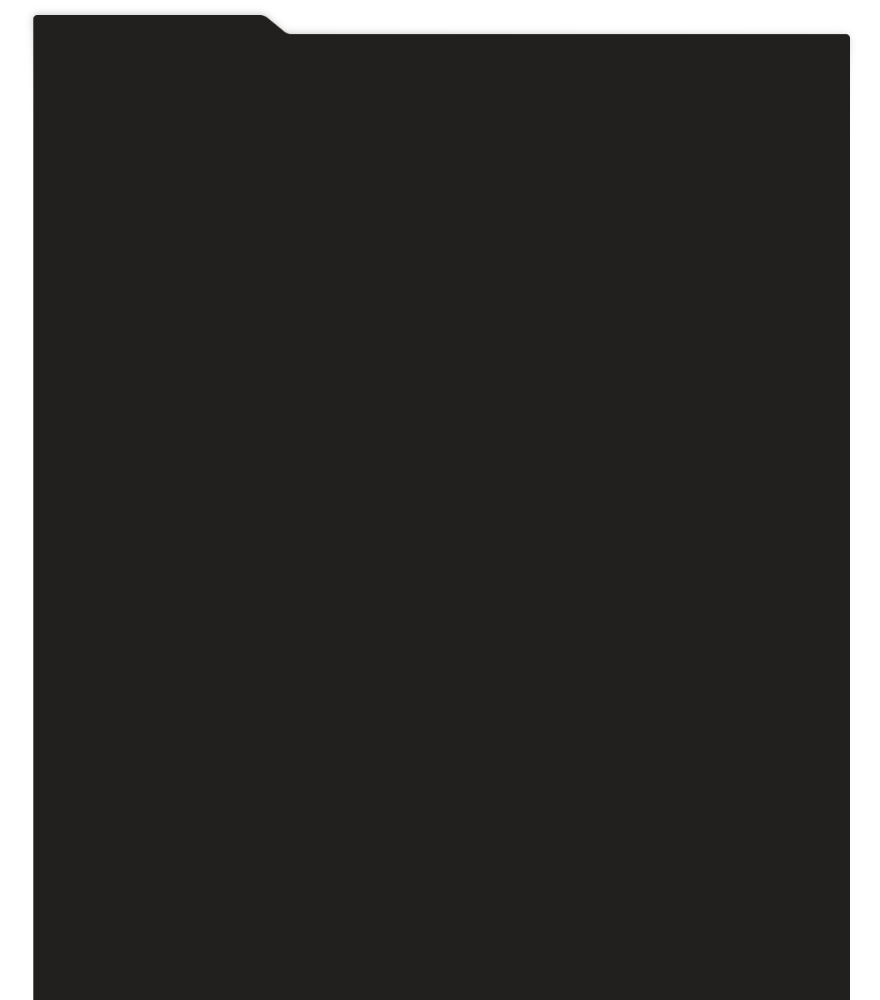
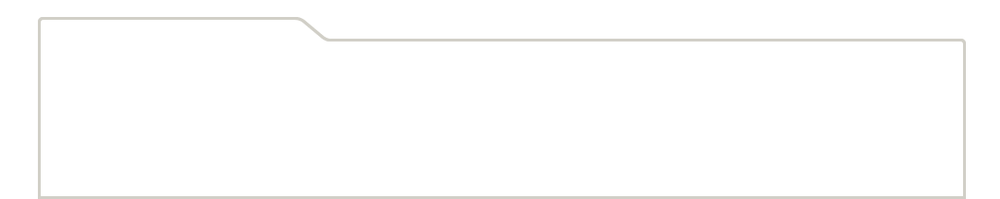
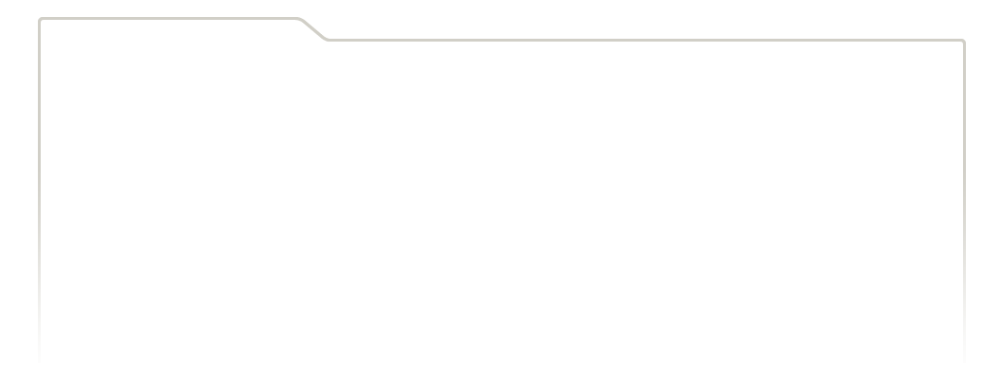
...
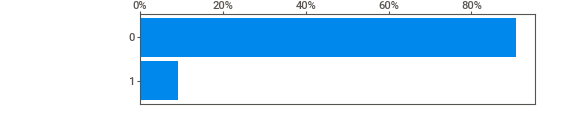
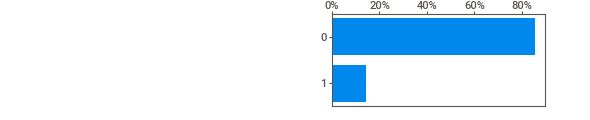
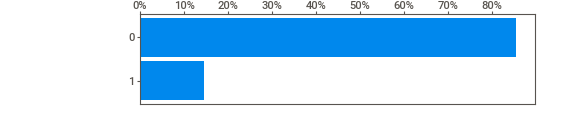
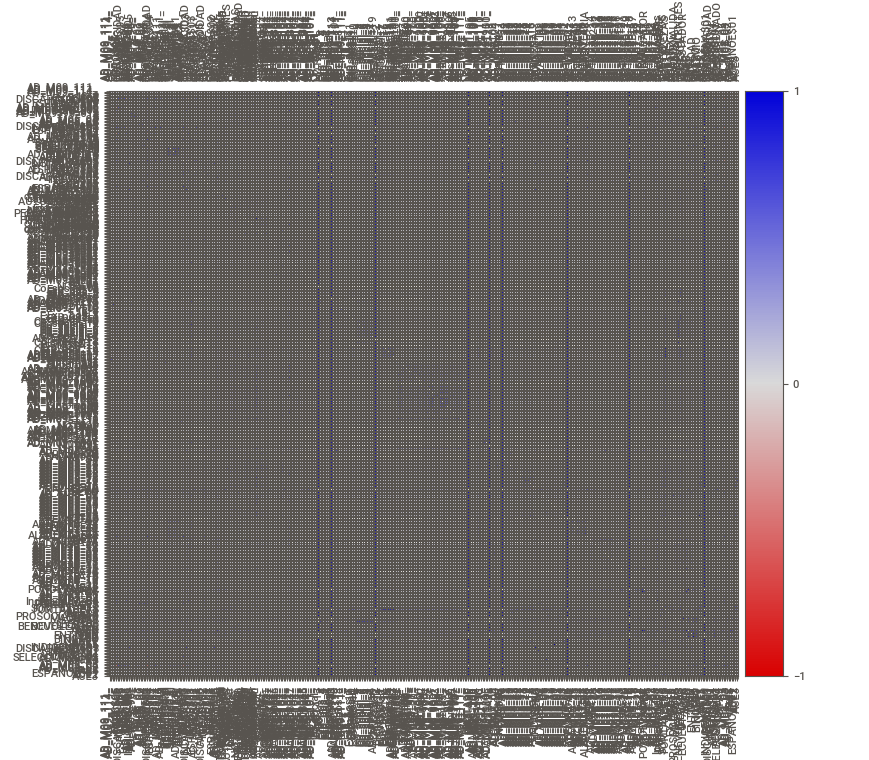
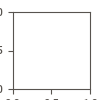

In [ ]:
report_num.show_notebook()

In [ ]:
# Guardamos el reporte en un srchivo html
report_num.show_html('sweetviz_report_full DF.html')

Report sweetviz_report_full DF.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


# Codificación de datos categóricos

In [ ]:
# Creamos listas de variables numéricas y categóricas en todo el data frame para hacer EDA
high_freq_lst = []
low_freq_lst = []
ord_lst = []


for col in df_adultos2:
    if  df_adultos2[col].nunique()>10:
        high_freq_lst.append(col)
    elif df_adultos2[col].nunique()<=2:
      low_freq_lst.append(col)
    elif df_adultos2[col].nunique() <= 10:
      ord_lst.append(col)

num_var = df_adultos2[high_freq_lst].select_dtypes(exclude='object').columns # Variables numéricas
bin_var = df_adultos2[low_freq_lst].columns # Variables binarias
cat_var = df_adultos2[high_freq_lst].select_dtypes(include='object').columns # Variables categóricas
ord_var = df_adultos2[ord_lst].columns # Variables ordinales
cat_lst = list(bin_var) + list(cat_var) + list(ord_var)
freq_lst = list(bin_var) + list(cat_var) + list(num_var)

In [ ]:
from feature_engine.encoding import OrdinalEncoder

enc = OrdinalEncoder(encoding_method="arbitrary", variables=list(ord_var))

In [ ]:
#enc.fit(X_train.astype('object'))
enc.fit(df_adultos2.astype('object'))

OrdinalEncoder(encoding_method='arbitrary',
               variables=['AD_M09_111_13_2', 'AD_M09_111_11_2', 'INT_ID$05',
                          'AD_M09_96_01_3', 'AD_M09_96_01_7', 'AD_M09_96_01_6',
                          'AD_M06_03', 'AD_M08_26', 'AD_M06_02', 'AD_M06_04',
                          'INT_ID$04', 'AD_M09_111_05_2', 'AD_M05_03',
                          'AD_M09_111_10_2', 'Seguridad alimentaria 3',
                          'Seguridad alimentaria 2', 'AD_M07_49', 'AD_M07_25',
                          'AD_M09_111_06_2', 'AD_M09_111_01_2', 'AD_M05_05',
                          'LATITUD', 'AD_M07_13', 'AD_M09_111_02_2',
                          'AD_M09_111_03_2', 'ESCOLARIDAD', 'AD_M05_06',
                          'AD_M13_121', 'AD_M08_36', 'AD_M08_37', ...])

In [ ]:
df_adultos = enc.transform(df_adultos2)

# Codificación de variables de alta cardinalidad

In [ ]:
from feature_engine.encoding import OneHotEncoder

#ohe_enc = OneHotEncoder(top_categories=3, variables= freq_lst, drop_last_binary=True)
ohe_enc = OneHotEncoder(top_categories=3, variables= freq_lst, drop_last_binary=True)

In [ ]:
#ohe_enc.fit(X_train.astype(object))
ohe_enc.fit(df_adultos.astype(object))

OneHotEncoder(drop_last_binary=True, top_categories=3,
              variables=['AD_M09_114_03', 'OTRO$05', 'ESPANOL$05',
                         'DISCAPACIDAD$05', 'LEER$05', 'SEXO$05', 'INDIGENA$05',
                         'AD_M09_96_01_5', 'AD_M09_96', 'INDIGENA$04',
                         'ESPANOL$04', 'DISCAPACIDAD$04', 'SEXO$04', 'LEER$04',
                         'OTRO$04', 'Seguridad alimentaria 6',
                         'Seguridad alimentaria 4', 'Seguridad alimentaria 5',
                         'Seguridad alimentaria 7', 'SEXO$03', 'INDIGENA$03',
                         'DISCAPACIDAD$03', 'INT_ID$03', 'ESPANOL$03',
                         'LEER$03', 'OTRO$03', 'INT_ID$02', 'DISCAPACIDAD$02',
                         'SEXO$02', 'LEER$02', ...])

In [ ]:
#X_train_enc = ohe_enc.transform(X_train)
#X_test_enc = ohe_enc.transform(X_test)
df_adultos_enc = ohe_enc.transform(df_adultos)

In [ ]:
# Usamos OHE para las variables de salida
#ohe_enc_target = OneHotEncoder(top_categories=1, variables=list(y_train.columns),drop_last_binary=True,ignore_format=True)
ohe_enc_target = OneHotEncoder(top_categories=1, variables=list(y.columns),drop_last_binary=True,ignore_format=True)

In [ ]:
#ohe_enc_target.fit(y_train.astype(object))
ohe_enc_target.fit(y.astype(object))

OneHotEncoder(drop_last_binary=True, ignore_format=True, top_categories=1,
              variables=['Depresion', 'Ansiedad',
                         'TRANSTORNO_ESTRES POSTRAUMÁTICO',
                         'SOSPECHA DE ANOREXIA/BULIMIA'])

In [ ]:
#y_train_enc = ohe_enc_target.transform(y_train)
#y_test_enc = ohe_enc_target.transform(y_test)
y_enc = ohe_enc_target.transform(y)

# Filtrado de datos: Chi-Squared Test

In [ ]:
# chi-squared test with similar proportions
from scipy.stats import chi2_contingency
from scipy.stats import chi2

stat, p, dof, expected = chi2_contingency(np.array(df_adultos_enc))
print('dof=%d' % dof)
print(expected)


dof=715896
[[0.0836721  0.06763133 0.00303474 ... 0.03121446 0.03034739 0.02731265]
 [0.10217246 0.082585   0.00370574 ... 0.03811615 0.03705737 0.03335163]
 [0.11520681 0.09312053 0.00417849 ... 0.04297871 0.04178485 0.03760637]
 ...
 [0.1198319  0.09685895 0.00434623 ... 0.04470413 0.04346235 0.03911611]
 [0.13749134 0.1111329  0.00498673 ... 0.05129211 0.04986733 0.04488059]
 [0.14001412 0.11317203 0.00507823 ... 0.05223325 0.05078232 0.04570409]]


In [ ]:
# interpret test-statistic
prob = 0.95
critical = chi2.ppf(prob, dof)
print('probability=%.3f, critical=%.3f, stat=%.3f' % (prob, critical, stat))

probability=0.950, critical=717865.327, stat=522328.374


In [ ]:
if abs(stat) >= critical:
	print('Dependent (reject H0)')
else:
	print('Independent (fail to reject H0)')

Independent (fail to reject H0)


In [ ]:
# interpret p-value
alpha = 1.0 - prob
print('significance=%.3f, p=%.3f' % (alpha, p))
if p <= alpha:
	print('Dependent (reject H0)')
else:
	print('Independent (fail to reject H0)')

significance=0.050, p=1.000
Independent (fail to reject H0)


In [ ]:
from sklearn.feature_selection import chi2

targets = ['Depresion_1.0', 'Ansiedad_1.0',
           'SOSPECHA DE ANOREXIA/BULIMIA_1.0',
           'TRANSTORNO_ESTRES POSTRAUMÁTICO_1.0']

p_value_lst = []
chi_scores_lst = []

for i in range(len(y.columns)):

  chi_scores = chi2(df_adultos_enc, y_enc.iloc[:,i])
  chi_scores_lst.append(chi_scores)


In [ ]:
for scores in chi_scores_lst:
  x1, x2 = scores
  p_values = pd.Series(scores[1],index = df_adultos_enc.columns)
  p_value_lst.append(p_values)

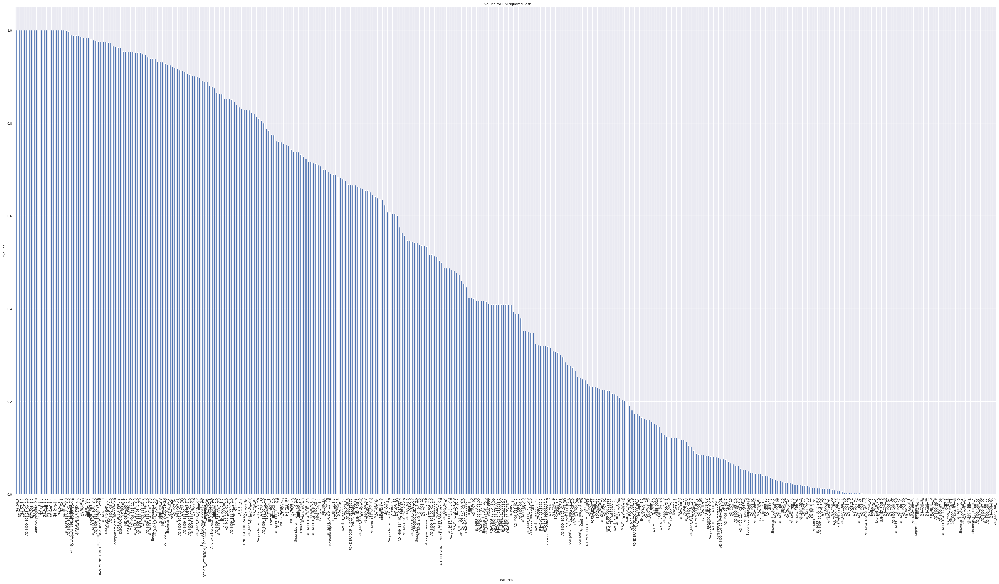

In [ ]:
# Create a figure with a specific size
fig, ax = plt.subplots(figsize=(50, 25))

# Plot the p_values for y_train_enc.iloc[:,0] (1st target)
p_values.plot(kind='bar', ax=ax)

# Set labels and title
ax.set_xlabel('Features')
ax.set_ylabel('P-values')
ax.set_title('P-values for Chi-squared Test')

# Show the plot
plt.show()

#p_values.plot.bar()

Seleccionamos solamente aquellas variables que estén por debajo del nivel de significancia estadística de P-value de 0.05, lo cual nos brinda una mayor certeza sobre la dependencia de las variables de salida con las variables de entrada seleccionadas.

In [ ]:
filtered_lst =[]

for x in p_value_lst[0]:
  if x <= 0.05:
    filtered_lst.append(p_value_lst[0][p_value_lst[0] == x].index[0])
    #print(x)
filtered_lst = list(set(filtered_lst))

In [ ]:
# Verificamos el nuevo tamaño de datos

len(filtered_lst)

148

In [ ]:
p_values = p_values.sort_values(ascending=False)

# Reducción de dimensionalidad - MCA (Multiple Component Analysis)

Utilizamos MCA para representar los datos en un plano de baja dimensionalidad con base en una tabla de contingencia que captura las frecuencias que cada combinación de categorías tiene en nuestro conjunto de datos para posteriormente aplicar PCA para explicar la mayor varianza posible en el conjunto de datos y que se traduce en información útil para los modelos de clasificación.

In [ ]:
import prince

mca = prince.MCA(one_hot=False,n_components=5, random_state=42)
#mca_result = mca.fit(X_train_enc)
mca_result = mca.fit(df_adultos_enc[filtered_lst])

In [ ]:
# obtain main components
main_comp_X_train = mca_result.eigenvalues_summary
main_comp_X_train

,eigenvalue,% of variance,% of variance (cumulative)
component,,,
0,0.112,8.21%,8.21%
1,0.071,5.22%,13.44%
2,0.055,4.03%,17.46%
3,0.051,3.72%,21.19%
4,0.039,2.89%,24.08%


In [ ]:
mca.plot(
    df_adultos_enc,
    x_component=0,
    y_component=2,
    show_column_markers=True,
    show_row_markers=True,
    show_column_labels=False,
    show_row_labels=False
)

alt.LayerChart(...)

In [ ]:
contributions = mca.column_contributions_.style.format('{:.0%}')
contrib_df = pd.DataFrame(contributions.data)

In [ ]:
contrib_df.to_csv('OHE_5comp_X_train_enc v6.csv')

In [ ]:
# Seleccionamos variables de nuestro Data Frame con 85% de variabilidad acumulada

# Sorting values in descending order
sorted_column =contrib_df[0].sort_values(ascending=False)

# Creating a new DataFrame with variables that make up 85% of cumulative sum
cumulative_percent_threshold = .85
cumulative_sum = 0
selected_variables = []

#asoc_lst = ['AD_M09_106','AD_M09_108_2.0','AD_M09_105','AD_M09_109']

#for x in asoc_lst:
 # selected_variables.append(x)

for variable, value in sorted_column.items():
    cumulative_sum += float(value)
    selected_variables.append(variable)

    if cumulative_sum >= cumulative_percent_threshold:
        break

#X_train_enc = X_train_enc[selected_variables]
df_adultos_enc = df_adultos_enc[selected_variables]

In [ ]:
# Vemos la reducción en la dimensionalidad

print("Dimensiones de variables antes de MCA: ",df_adultos.shape)
print("Dimensiones de variables después de MCA: ",df_adultos_enc.shape)


Dimensiones de variables antes de MCA:  (1468, 343)
Dimensiones de variables después de MCA:  (1468, 38)


In [ ]:
y_data = y.copy()

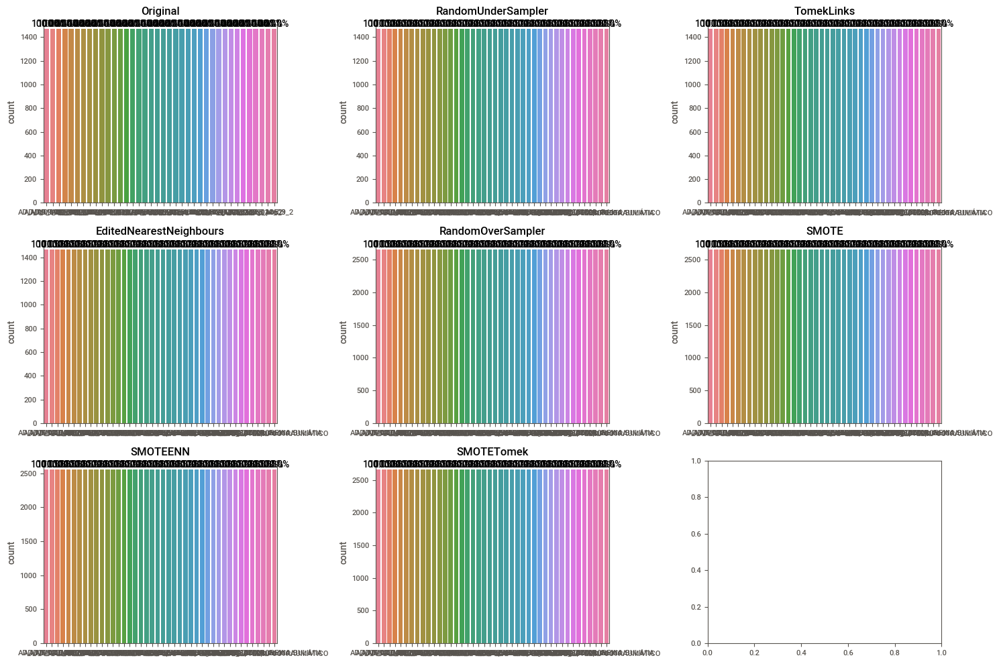

In [ ]:
# balancing the dataset

models = [

    ('Original', df_adultos_),

    ('RandomUnderSampler', RandomUnderSampler(sampling_strategy='auto')),

    ('TomekLinks', TomekLinks(sampling_strategy='auto')),

    ('EditedNearestNeighbours', EditedNearestNeighbours(sampling_strategy='auto')),

    ('RandomOverSampler', RandomOverSampler(sampling_strategy='auto')),

    ('SMOTE', SMOTE(sampling_strategy='auto')),

    ('SMOTEENN', SMOTEENN(sampling_strategy='auto')),

    ('SMOTETomek', SMOTETomek(sampling_strategy='auto')),

]



fig, ax = plt.subplots(3, 3, figsize=(15, 10))

ax = ax.ravel()



for i, (name, model) in enumerate(models):

    if name == 'Original':

        data = df_adultos_

    else:

        data = df_adultos_.copy()



        # fit the model

        Xr, y1 = model.fit_resample(data, y_data['TRANSTORNO_ESTRES POSTRAUMÁTICO'])
        Xr, y2 = model.fit_resample(data, y_data['SOSPECHA DE ANOREXIA/BULIMIA'])
        y3 = y_data[['Depresion','Ansiedad']]
        data = pd.concat([Xr, y1, y2, y3], axis=1)



    sns.countplot(data=data, ax=ax[i])

    # annotate percentage

    total = len(data)

    for p in ax[i].patches:

        percentage = '{:.1f}%'.format(100 * p.get_height() / total)

        x = p.get_x() + p.get_width() / 2

        y = p.get_height()

        ax[i].annotate(percentage, (x, y), ha='center', va='bottom')

    ax[i].set_title(name)



plt.tight_layout()

plt.show()



In [ ]:
rs_y = data[['Depresion',	'Ansiedad','TRANSTORNO_ESTRES POSTRAUMÁTICO', 'SOSPECHA DE ANOREXIA/BULIMIA']]
data.drop(columns=['Depresion',	'Ansiedad','TRANSTORNO_ESTRES POSTRAUMÁTICO', 'SOSPECHA DE ANOREXIA/BULIMIA'], inplace=True)

In [ ]:
new_lst = ['AD_M09_100_03','AD_M09_100_12','AD_M09_100_13','AD_M09_100_01',
       'AD_M08_21','AD_M08_22', 'AD_M09_100_14','AD_M08_19','AD_M09_100_19',
       'AD_M09_100_16','AD_M08_20', 'AD_M09_100_17','AD_M09_97_07',
       'AD_M09_97_08','Síntomas_trastornos_5','AD_M09_99_5','AD_M08_02',
       'AD_M08_32','AD_M09_99_7', 'AD_M09_99_4','AD_M08_31',
       'Síntomas_trastornos_3','AD_M09_99_3','AD_M08_30','IndicadorMas4',
       'ACE3','Depresión_pregunta','SUM_EX_POS',
       'AD_M09_96_01_2','AD_M09_111_02_2','FORTALEZAS','AD_M07_47',
       'AD_M08_33','AD_M08_03', 'AD_M09_106','AD_M09_111_03_2',
       'Exp_pos_9','ACE2']

In [ ]:
#df_adultos_ = df_adultos[new_lst]


In [ ]:
# Definimos nuestros conjuntos de entrenamiento, prueba y validación
X_train, X_test, y_train, y_test = train_test_split(data[new_lst], rs_y, test_size=0.3, random_state=0, shuffle=True)
#X_train, X_test, y_train, y_test = train_test_split(df_adultos_, y, test_size=0.3, random_state=0, shuffle=True)

In [ ]:
# Creamos listas de variables numéricas y categóricas
high_freq_lst = []
low_freq_lst = []
ord_lst = []


for col in X_train:
    if  X_train[col].nunique()>10:
        high_freq_lst.append(col)
    elif X_train[col].nunique()<=2:
      low_freq_lst.append(col)
    elif X_train[col].nunique() <= 10:
      ord_lst.append(col)

num_var = X_train[high_freq_lst].select_dtypes(exclude='object').columns # Variables numéricas
bin_var = X_train[low_freq_lst].columns # Variables binarias
cat_var = X_train[high_freq_lst].select_dtypes(include='object').columns # Variables categóricas
ord_var = X_train[ord_lst].columns # Variables ordinales
ord_lst = list(bin_var) +list(ord_var)#+ list(cat_var)
freq_lst = list(cat_var) + list(num_var)

In [ ]:
# Transformaciones a factores numéricos de entrada:

cat_pipeline = Pipeline(steps = [('impModa', SimpleImputer(strategy='most_frequent')),
                                  #('ord_Enc', OrdinalEncoder(encoding_method="arbitrary", variables= freq_lst, ignore_format=True)),
                                  ('freq_Enc', OneHotEncoder(top_categories=1, drop_last_binary=True)),
                                 ('escalaCat', MinMaxScaler(feature_range=(0,1))),
                                 ])
cat_pipeline_nombres = X_train.columns

# Conjuntamos las transformaciones numéricas que se estarán aplicando a los datos de entrada:
columnasTransformerX = ColumnTransformer(transformers = [('catpipe', cat_pipeline, cat_pipeline_nombres)],
                                                        #('numpipe', num_pipeline, num_pipeline_nombres)],
                                        remainder='passthrough')

In [ ]:
# Transformaciones a variables de salida:
y_pipeline = Pipeline(steps = [('impModa', SimpleImputer(strategy='most_frequent')),
                              ('freq_Enc', OneHotEncoder(top_categories=1, drop_last_binary=True)),
                                ('escalaCat', MinMaxScaler(feature_range=(0,1))),
                                ])
y_pipeline_nombres = y_train.columns

# Conjuntamos las transformaciones numéricas que se estarán aplicando a los datos de entrada:
columnasTransformerY = ColumnTransformer(transformers = [('ypipe', y_pipeline, y_pipeline_nombres)],
                                      remainder='passthrough')

In [ ]:
transformed_df = columnasTransformerX.fit(X_train.astype('object'))

In [ ]:
Ytransformed_df = columnasTransformerY.fit_transform(y_train.astype('object'))
#y_train.columns[0]

## Métricas de desempeño

En el caso de problemas de clasificación y en especial donde existe sesgo en los conjuntos de datos (clases con mayor frecuancia que otras), no se sugiere utilizar Exactitud, la cual se centra en la clase mayoritaria, lo cual en nuestro caso implicaría que la clase minoritaria tendría más errores, que se traduciría en Falsos Negativos o diagnósticos negativos sobre alguna enfermedad. Para este tipo de problemas se recomienda utilizar la tasa de Verdaderos Positivos o Sensitividad, así como la exactitud sobre la clase positiva o Presición. También es útil combinar las dos, sobre todo para evaluar diferentes modelos con la misma métrica, como lo es F1-Score, conocido como la media harmónica de las dos métricas referidas:
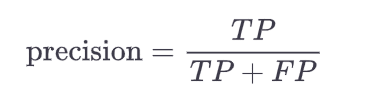

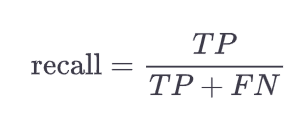

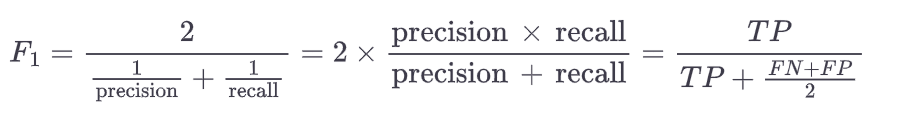



# Modelos de clasificación

Utilizamos modelos de clasificación binaria sobre cada una de las variables de salida de manera independiente, es decir, en este punto no estamos obteniendo resultados simultáneamente sobre todos los padecimientos en cada predicción a manera de obtener un baseline que nos permita un ajuste fino posterior. Para este fin al hacer OHE sobre las categoría de mayor frecuencia, nos permitió reflejar si el diagnóstico fue positivo o negativo, independientemente de la severidad del padecimiento.

In [ ]:
import warnings
warnings.filterwarnings("ignore")#, category=DeprecationWarning)

In [ ]:
from sklearn import metrics


# Seleccionamos primeramente nuestro modelo de aprendizaje automático, en este caso el de regresión lineal múltiple:
modelo_LR = LogisticRegression(max_iter=1000)

scoresR2Train = []       # R2 del conjunto de entrenamiento.
scoresR2Val = []         # R2 del conjunto de validación con filtración.
scoresmiR2Val = []       # R2 del conjunto de validación sin filtración.
scoresmiR2adjVal = []    # R2 ajustada sin filtración.
scoresRMSEVal = []       # RMSE

# Inicializamos validación-cruzada usando KFold con k=n_splits particiones.

k = 5  # total de particiones (folds)
kf = KFold(n_splits= k, shuffle=True)

targets = ['Depresion', 'Ansiedad', 'TRANSTORNO_ESTRES POSTRAUMÁTICO',
       'SOSPECHA DE ANOREXIA/BULIMIA']

for i in range(len(y_train.columns)):

  # Aplicamos validación-cruzada mediante la evaluación de cada una de las k particiones:
  for train_index, val_index in kf.split(X_train):

    # En cada partición definimos ahora sí el conjunto de entrenamiento y el de validación:
    Xtrain, X_val = X_train.iloc[train_index,:], X_train.iloc[val_index,:]
    ytrain, y_val = y_train.iloc[train_index,:], y_train.iloc[val_index,:]

    # Aplicamos las transformaciones al conjunto de entrenamiento:
    XtrainFit = columnasTransformerX.fit(Xtrain.astype('object'))   # Generamos la información necesaria con el conjunto de entrenamiento.
    ytrainFit = columnasTransformerY.fit(ytrain.astype('object'))
    XtrainTransf = XtrainFit.transform(Xtrain)    # y aplicamos dichas transformaciones al conjunto de entrenamiento,
    ytrainTransf = ytrainFit.transform(ytrain)
    XvalTransf  =  XtrainFit.transform(X_val)
    yvalTransf  =  ytrainFit.transform(y_val)      # y al conjunto de validación.
    ymtrain = np.mean(ytrain)   # También requeriremos el promedio de las observaciones de entrenamiento para calcular Syy.

    scores_train = cross_val_score(modelo_LR, XtrainTransf, ytrainTransf.reshape(4,ytrainTransf.shape[0])[i], cv=5, scoring='recall',)
    scores_val = cross_val_score(modelo_LR, XvalTransf , yvalTransf.reshape(4,yvalTransf.shape[0])[i], cv=5, scoring='recall')

  # guardamos el desempeño R2 con los datos de entrenamiento.
    scoresR2Train.append(scores_train)
    scoresR2Val.append(scores_val)

In [ ]:

models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Decision Tree": DecisionTreeClassifier(),
    "Support Vector Machine": SVC(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Random Forest": RandomForestClassifier(),
   "Gradient Boosting": GradientBoostingClassifier()
}

print('Promedios de Precisión por Validación Cruzada', '\n')

tabla=[]
counter=0

for name,model in models.items():
  for n in range(len(y_train.columns)):
    for num in range(len(scores)):
      tabla.append([np.mean(scoresR2Train[n]), np.std(scoresR2Train[n]),
                    np.mean(scoresR2Val[n]), np.std(scoresR2Val[n])])

      print(f'{name} sobre {y_train.columns[i]}: \n\n',tabulate(list(tabla)[counter:],
              headers=["Train(mean)", "Train(std)", "Test(mean)", "Test(std)"],
              #headers=["Precision(mean)", "Recall(mean)", "F1(mean)"],
              tablefmt="github",
              floatfmt=".2f"
              ) ,'\n')
      counter += 1

Promedios de Precisión por Validación Cruzada 

Logistic Regression sobre SOSPECHA DE ANOREXIA/BULIMIA: 

 |   Train(mean) |   Train(std) |   Test(mean) |   Test(std) |
|---------------|--------------|--------------|-------------|
|          0.99 |         0.00 |         0.94 |        0.03 | 

Logistic Regression sobre SOSPECHA DE ANOREXIA/BULIMIA: 

 |   Train(mean) |   Train(std) |   Test(mean) |   Test(std) |
|---------------|--------------|--------------|-------------|
|          0.99 |         0.00 |         0.94 |        0.03 | 

Logistic Regression sobre SOSPECHA DE ANOREXIA/BULIMIA: 

 |   Train(mean) |   Train(std) |   Test(mean) |   Test(std) |
|---------------|--------------|--------------|-------------|
|          0.98 |         0.01 |         0.89 |        0.06 | 

Logistic Regression sobre SOSPECHA DE ANOREXIA/BULIMIA: 

 |   Train(mean) |   Train(std) |   Test(mean) |   Test(std) |
|---------------|--------------|--------------|-------------|
|          0.98 |         0.

In [ ]:
# Iteramos sobre algunos modelos de clasificación para obtener resultados preliminares

models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Decision Tree": DecisionTreeClassifier(),
    "Support Vector Machine": SVC(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Random Forest": RandomForestClassifier(),
   "Gradient Boosting": GradientBoostingClassifier()
}


models_lst = [LogisticRegression(max_iter=500),DecisionTreeClassifier(),SVC(),KNeighborsClassifier(),RandomForestClassifier(),]

tabla = list()
counter = 0

for name,model in models.items():
  for i in range(len(y_train.columns)):

    # Aplicamos las transformaciones al conjunto de entrenamiento:
    XtrainFit = columnasTransformerX.fit(X_train.astype('object'))   # Generamos la información necesaria con el conjunto de entrenamiento.
    ytrainFit = columnasTransformerY.fit(y_train.astype('object'))
    XtrainTransf = XtrainFit.transform(X_train)    # y aplicamos dichas transformaciones al conjunto de entrenamiento,
    ytrainTransf = ytrainFit.transform(y_train)
    XtestlTransf  =  XtrainFit.transform(X_test)
    ytestTransf  =  ytrainFit.transform(y_test)      # y al conjunto de validación.

    model.fit(XtrainTransf, ytrainTransf.reshape(4,ytrainTransf.shape[0])[i])
    yhat = model.predict(XtestlTransf)

    acc = 100*model.score(XtestlTransf,ytestTransf.reshape(4,ytestTransf.shape[0])[i])

    cm = confusion_matrix(ytestTransf.reshape(4,ytestTransf.shape[0])[i], yhat)

    tot = cm.sum()

    vn = 100*cm[0,0] / tot
    fp = 100*cm[0,1] / tot
    fn = 100*cm[1,0] / tot
    vp = 100*cm[1,1] / tot

    precision = vp / ( vp+fp)
    recall = vp / (vp+fn)
    f1score = 2*vp / (2*vp+fp+fn)
    especificidad = vn / (vn+fp)
    gmean = np.sqrt(recall * especificidad)

    tabla.append([acc, vn, fp, fn, vp, precision, recall, f1score, gmean])

    print(f'Resumen de métricos para {name} sobre {y_train.columns[i]}: \n\n',tabulate(list(tabla)[counter:],
            headers=["Exact(%)", "VN(%)", "FP(%)", "FN(%)", "VP(%)", "precision", "recall", "f1score", "gmean"],
            tablefmt="github",
            floatfmt=".2f"
            ) ,'\n')
    counter += 1

Resumen de métricos para Logistic Regression sobre Depresion: 

 |   Exact(%) |   VN(%) |   FP(%) |   FN(%) |   VP(%) |   precision |   recall |   f1score |   gmean |
|------------|---------|---------|---------|---------|-------------|----------|-----------|---------|
|      73.22 |    0.00 |   26.66 |    0.13 |   73.22 |        0.73 |     1.00 |      0.85 |    0.00 | 

Resumen de métricos para Logistic Regression sobre Ansiedad: 

 |   Exact(%) |   VN(%) |   FP(%) |   FN(%) |   VP(%) |   precision |   recall |   f1score |   gmean |
|------------|---------|---------|---------|---------|-------------|----------|-----------|---------|
|      62.45 |    0.38 |   36.42 |    1.13 |   62.08 |        0.63 |     0.98 |      0.77 |    0.10 | 

Resumen de métricos para Logistic Regression sobre TRANSTORNO_ESTRES POSTRAUMÁTICO: 

 |   Exact(%) |   VN(%) |   FP(%) |   FN(%) |   VP(%) |   precision |   recall |   f1score |   gmean |
|------------|---------|---------|---------|---------|------------

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler

LR_pipe = Pipeline(steps=[('col_transformer', columnasTransformerX),
                          ('model',LogisticRegression(random_state=42) )
])

params = {'model__solver':['saga','sag'],
          'model__C':[0.01, 0.1, 1.0],
           'model__class_weight':['balanced',0.25],
           'model__max_iter':[300,500]}

gs_LR = GridSearchCV(LR_pipe,
                      param_grid=params,
                      scoring='precision',
                      cv=5,
                     return_train_score=True)
gs_LR.fit(X_train.astype('object'), y_train['SOSPECHA DE ANOREXIA/BULIMIA'])


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('col_transformer',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('catpipe',
                                                                         Pipeline(steps=[('impModa',
                                                                                          SimpleImputer(strategy='most_frequent')),
                                                                                         ('freq_Enc',
                                                                                          OneHotEncoder(drop_last_binary=True,
                                                                                                        top_categories=1)),
                                                                                         ('escalaCat',
                                                                                          MinMaxScaler())]),
                                                                         Index(['AD_M09_100_03', 'AD_M09_100_12', 'AD_M09_100_13'...
       'AD_M09_111_02_2', 'FORTALEZAS', 'AD_M07_47', 'AD_M08_33', 'AD_M08_03',
       'AD_M09_106', 'AD_M09_111_03_2', 'Exp_pos_9', 'ACE2'],
      dtype='object'))])),
                                       ('model',
                                        LogisticRegression(random_state=42))]),
             param_grid={'model__C': [0.01, 0.1, 1.0],
                         'model__class_weight': ['balanced', 0.25],
                         'model__max_iter': [300, 500],
                         'model__solver': ['saga', 'sag']},
             return_train_score=True, scoring='precision')

In [ ]:
#print(f'Average Train Score:', {gs_LR.cv_results_['mean_train_score'].mean()})
gs_LR.best_params_

{'model__C': 0.1,
 'model__class_weight': 'balanced',
 'model__max_iter': 300,
 'model__solver': 'saga'}

In [ ]:
SVC_pipe = Pipeline(steps=[('col_transformer', columnasTransformerX),
 ('model', SVC(random_state=42))])

params = {'model__C': [0.1,1, 10, 100], 'model__gamma': [1,0.1,0.01,0.001],'model__kernel': ['rbf', 'poly', 'sigmoid']}

gs_SVC = GridSearchCV(SVC_pipe,
                      param_grid=params,
                      scoring='precision',
                      cv=5,return_train_score=True)

gs_SVC.fit(X_train.astype('object'), y_train['SOSPECHA DE ANOREXIA/BULIMIA'])


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('col_transformer',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('catpipe',
                                                                         Pipeline(steps=[('impModa',
                                                                                          SimpleImputer(strategy='most_frequent')),
                                                                                         ('freq_Enc',
                                                                                          OneHotEncoder(drop_last_binary=True,
                                                                                                        top_categories=1)),
                                                                                         ('escalaCat',
                                                                                          MinMaxScaler())]),
                                                                         Index(['AD_M09_100_03', 'AD_M09_100_12', 'AD_M09_100_13'...
       'ACE3', 'Depresión_pregunta', 'SUM_EX_POS', 'AD_M09_96_01_2',
       'AD_M09_111_02_2', 'FORTALEZAS', 'AD_M07_47', 'AD_M08_33', 'AD_M08_03',
       'AD_M09_106', 'AD_M09_111_03_2', 'Exp_pos_9', 'ACE2'],
      dtype='object'))])),
                                       ('model', SVC(random_state=42))]),
             param_grid={'model__C': [0.1, 1, 10, 100],
                         'model__gamma': [1, 0.1, 0.01, 0.001],
                         'model__kernel': ['rbf', 'poly', 'sigmoid']},
             return_train_score=True, scoring='precision')

In [ ]:
#print(f'Average Train Score:', {gs_LR.cv_results_['mean_train_score'].mean()})
gs_SVC.best_params_

{'model__C': 1, 'model__gamma': 0.1, 'model__kernel': 'rbf'}

De manera preliminar, estaríamos trabajando en verificar si el modelo Linear Regression o Support Vector Classifier son los mejores desde el punto de vista de subajuste/sobreajuste.

In [ ]:
import pandas as pd
import requests
from io import BytesIO

# Cargamos el archivo Excel

file_path = 'https://raw.githubusercontent.com/danielav081596/Proyecto_Integrador_Equipo5/main/2.2.Base de ACES_Menores.xlsx'
response = requests.get(file_path, timeout=50)  # Adjust the timeout as needed.

data = BytesIO(response.content)
df = pd.read_excel(data)

# Verificamos las primeras filas del dataframe para entender su estructura
df.head()

,FOLIO,FOLIO2,VERSION,FILTRO,ENT,ENTIDAD,MUN,MUNICIPIO,LOC,LOCALIDAD,...,GPOEDAD,ESCOLARIDAD,HERMANOS,ACT_FAM,NLIBROS,NOVIOLENCIA,VIOLENCIA_FIS,VIOLENCIA_PSIC,VIOLENCIA,VIOLENCIA_SEVERA
0,0100108639999001-01,0100108639999001-01,VER02,2,1,AGUASCALIENTES,1,AGUASCALIENTES,863,COTORINA (COYOTES),...,1.0,2.0,1.0,2,0,0.0,0.0,0.0,1.0,0.0
1,0100108639999001-03,0100108639999001-03,VER02,2,1,AGUASCALIENTES,1,AGUASCALIENTES,863,COTORINA (COYOTES),...,NaN,1.0,1.0,1,0,0.0,0.0,1.0,1.0,0.0
2,0100108639999001-04,0100108639999001-04,VER02,2,1,AGUASCALIENTES,1,AGUASCALIENTES,863,COTORINA (COYOTES),...,NaN,1.0,1.0,2,0,1.0,0.0,0.0,0.0,0.0
3,0100108639999001-05,0100108639999001-05,VER02,2,1,AGUASCALIENTES,1,AGUASCALIENTES,863,COTORINA (COYOTES),...,2.0,1.0,1.0,2,0,0.0,0.0,0.0,1.0,0.0
4,0100108639999002-02,0100108639999002-02,VER02,2,1,AGUASCALIENTES,1,AGUASCALIENTES,863,COTORINA (COYOTES),...,2.0,1.0,1.0,1,0,0.0,1.0,0.0,1.0,0.0


In [ ]:
# Columns a eliminar irrelevantes para la evaluacion
columns_to_remove = [
    "NN_M06_09", "NN_M06_10_1", "NN_M06_10_2", "NN_M06_10_3", "NN_M06_10_4",
    "NN_M06_10_5", "NN_M06_10_6", "NN_M06_10_7", "NN_M06_10_8", "NN_M05_18",
    "NN_M05_19", "NN_M06_02", "NN_M06_03", "NN_M06_04", "NN_M06_07",
    "NN_M06_10_9", "NN_M06_10_10", "NN_M06_10_11", "NN_M06_10_12",
    "NN_M06_10_13", "NN_M06_10_14", "NN_M06_10_15", "NN_M06_10_16",
    "NN_M07_05", "NN_M07_06", "NN_M07_18B", "NN_M07_19A2", "NN_M07_19B2",
    "NN_M07_19C2", "NN_M07_19D2", "NN_M07_19E2", "NN_M07_19F2", "NN_M07_19G2",
    "NN_M07_22", "NN_MO7_25V", "NN_M07_26", "NN_M14_02", "NN_M14_04",
    "NN_M14_06", "NN_M14_08", "NN_M03_02", "NN_M03_03", "NN_M03_04",
    "NN_M03_05", "NN_M03_06", "FOLIO2","FOLIO","MESES_CALC","DIAS_CALC", "VERSION", "FILTRO", "ENT", "ENTIDAD",
    "MUN","LOC","AGEB", "MZN", "ENC", "MAQUINA",
    "GPS1", "LATITUD", "LONGITUD","PEARLS_Pte1","NM_M04_01","NN_M04_04","NN_M04_06","NN_M04_07", "GPOEDAD","NN_M04_05","NN_M05_02", "NM_M04_03",
    "NN_M05_10", "NN_M07_01", "NN_M07_02", "NN_M07_03", "NN_M07_17", "NN_M07_18",
    "NN_M12_01", "NN_M12_261", "NN_M13_09", "EDADM", "HERMANOS","PONDERADOR"
]

# Remover columnas
df_cleaned = df.drop(columns=[col for col in columns_to_remove if col in df.columns], errors='ignore')

df_cleaned.head()

,MUNICIPIO,LOCALIDAD,EDAD_CALC,NN_M04_08,NN_M04_09,NN_M04_10,NN_M04_11,NN_M04_12,NN_M04_13,NOTA5,...,RURAL,AREA,ESCOLARIDAD,ACT_FAM,NLIBROS,NOVIOLENCIA,VIOLENCIA_FIS,VIOLENCIA_PSIC,VIOLENCIA,VIOLENCIA_SEVERA
0,AGUASCALIENTES,COTORINA (COYOTES),3,NaN,4,NaN,1,2.0,2,1,...,1,1,2.0,2,0,0.0,0.0,0.0,1.0,0.0
1,AGUASCALIENTES,COTORINA (COYOTES),5,NaN,3,NaN,1,1.0,2,1,...,1,1,1.0,1,0,0.0,0.0,1.0,1.0,0.0
2,AGUASCALIENTES,COTORINA (COYOTES),5,NaN,3,NaN,1,1.0,2,1,...,1,1,1.0,2,0,1.0,0.0,0.0,0.0,0.0
3,AGUASCALIENTES,COTORINA (COYOTES),4,NaN,2,NaN,1,3.0,3,1,...,1,1,1.0,2,0,0.0,0.0,0.0,1.0,0.0
4,AGUASCALIENTES,COTORINA (COYOTES),4,NaN,2,NaN,1,1.0,1,1,...,1,1,1.0,1,0,0.0,1.0,0.0,1.0,0.0


In [ ]:
# Buscamos y eliminamos columnas que coincidan con el patrón "NOTA(numero)"
import re

# Patrón para identificar las columnas con el formato "NOTA(numero)"
pattern = re.compile(r'NOTA\d+')

# Filtramos las columnas que coinciden con el patrón
columns_to_remove = [col for col in df_cleaned.columns if pattern.match(col)]

# Eliminamos las columnas identificadas del dataframe
df_cleaned_filtered = df_cleaned.drop(columns=columns_to_remove, errors='ignore')

# Mostramos las columnas eliminadas y la nueva dimensión del dataframe
columns_to_remove, df_cleaned_filtered.shape

(['NOTA5',
  'NOTA6',
  'NOTA7',
  'NOTA8',
  'NOTA9',
  'NOTA10',
  'NOTA11A',
  'NOTA11B',
  'NOTA11C',
  'NOTA11D',
  'NOTA12',
  'NOTA121',
  'NOTA13',
  'NOTA14'],
 (249, 301))

In [ ]:
# Removemos filas duplicadas
df_no_duplicates = df_cleaned_filtered.drop_duplicates()

# Calculamos el porcentaje de datos faltantes por columna
missing_data_percent = df_no_duplicates.isnull().mean() * 100

# Filtramos las columnas para remover aquellas con más del 50% de datos faltantes
columns_to_keep = missing_data_percent[missing_data_percent <= 50].index

# Mantenemos solo las columnas seleccionadas
df_filtered_final = df_no_duplicates[columns_to_keep]

# Resultados
df_no_duplicates_shape = df_no_duplicates.shape
df_filtered_final_shape = df_filtered_final.shape
df_no_duplicates_shape, df_filtered_final_shape

((249, 301), (249, 221))

In [ ]:
# Reemplazar los valores 999 por 0 en todo el DataFrame
df_filtered_final = df_filtered_final.replace(999,0)

# Verificar el reemplazo mostrando nuevamente las primeras filas
df_filtered_final.head()

,MUNICIPIO,LOCALIDAD,EDAD_CALC,NN_M04_09,NN_M04_11,NN_M04_12,NN_M04_13,NN_M05_01,NN_M05_03,NN_M05_04,...,RURAL,AREA,ESCOLARIDAD,ACT_FAM,NLIBROS,NOVIOLENCIA,VIOLENCIA_FIS,VIOLENCIA_PSIC,VIOLENCIA,VIOLENCIA_SEVERA
0,AGUASCALIENTES,COTORINA (COYOTES),3,4,1,2.0,2,23,1,1,...,1,1,2.0,2,0,0.0,0.0,0.0,1.0,0.0
1,AGUASCALIENTES,COTORINA (COYOTES),5,3,1,1.0,2,25,1,2,...,1,1,1.0,1,0,0.0,0.0,1.0,1.0,0.0
2,AGUASCALIENTES,COTORINA (COYOTES),5,3,1,1.0,2,21,1,2,...,1,1,1.0,2,0,1.0,0.0,0.0,0.0,0.0
3,AGUASCALIENTES,COTORINA (COYOTES),4,2,1,3.0,3,28,1,2,...,1,1,1.0,2,0,0.0,0.0,0.0,1.0,0.0
4,AGUASCALIENTES,COTORINA (COYOTES),4,2,1,1.0,1,14,1,2,...,1,1,1.0,1,0,0.0,1.0,0.0,1.0,0.0


In [ ]:
# Contar cuántas veces se usó el valor 8 en todas las columnas del DataFrame
count_8_per_column = df_filtered_final.apply(lambda x: (x == 123).sum())

# Filtrar solo las columnas donde el conteo es mayor que 0 para simplificar la visualización
columns_with_8 = count_8_per_column[count_8_per_column > 0]

columns_with_8

NN_M10_04A     9
NN_M10_04B     9
NN_M10_04C    11
NN_M10_04D    11
NN_M10_04E    22
NN_M10_04F    16
NN_M10_04G    16
dtype: int64

In [ ]:
for col in df_filtered_final.columns:
    mode_value = df_filtered_final[col].mode()[0]  # Tomamos la primera moda si hay múltiples
    df_filtered_final[col].fillna(mode_value, inplace=True)

In [ ]:
# Cargamos el diccionario de la encuesta para identificar las columnas de clasificación

diccionario_path ='https://raw.githubusercontent.com/danielav081596/Proyecto_Integrador_Equipo5/main/Diccionario%20Encuestas%20Ni%C3%B1os.xlsx'
response = requests.get(file_path, timeout=50)  # Adjust the timeout as needed.

data = BytesIO(response.content)
diccionario_df = pd.read_excel(diccionario_path)

# Verificamos las primeras filas del dataframe para entender su estructura
df.head()

# Verificamos las primeras filas del diccionario para entender su estructura
diccionario_df.head()

,ID Columna,Categoria,Descripcion,Valores,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13
0,NM_M04_03,Individuo,FECHA DE NACIMIENTO DE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NM_M04_04,Individuo,¿FUE VERIFICADA LA FECHA DE NACIMIENTO?,1=SÍ,2=NO,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,EDAD_CALC,Individuo,EDAD_CALC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,MESES_CALC,Individuo,MESES_CALC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,DIAS_CALC,Individuo,DIAS_CALC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Filtramos las columnas que tienen valores definidos, indicando posiblemente una clasificación
columnas_con_valores_definidos = diccionario_df[diccionario_df['Valores'].notnull()]['ID Columna']

# Convertimos la serie en lista para facilitar la visualización
columnas_con_valores_definidos_list = columnas_con_valores_definidos.tolist()

columnas_con_valores_definidos_list

['NM_M04_04',
 'NN_M04_05',
 'NN_M04_09',
 'NN_M04_11',
 'NOTA5',
 'NN_M05_03',
 'NN_M05_04',
 'NN_M05_06',
 'NN_M05_08',
 'NN_M05_09',
 'NN_M05_10',
 'NN_M05_11',
 'NN_M05_12',
 'NN_M05_13',
 'NN_M05_14',
 'NN_M05_15',
 'NN_M05_17',
 'NN_M06_01',
 'NN_M06_05',
 'NN_M06_07',
 'NN_M06_09',
 'NN_M06_10_1',
 'NN_M06_10_2',
 'NN_M06_10_3',
 'NN_M06_10_4',
 'NN_M06_10_5',
 'NN_M06_10_6',
 'NN_M06_10_7',
 'NN_M06_10_8',
 'NN_M05_17',
 'NN_M06_01',
 'NN_M06_05',
 'NN_M06_07',
 'NN_M06_10_9',
 'NN_M06_10_10',
 'NN_M06_10_11',
 'NN_M06_10_12',
 'NN_M06_10_13',
 'NN_M06_10_14',
 'NN_M06_10_15',
 'NN_M06_10_16',
 'N_M07_01',
 'NN_M07_02',
 'NN_M07_03',
 'NN_M07_04',
 'NN_M07_07',
 'NN_M07_08',
 'NN_M07_11',
 'NN_M07_12',
 'NN_M07_13',
 'NN_M07_14',
 'NN_M07_15',
 'NN_M07_16',
 'NN_M07_17',
 'NN_M07_18',
 'NN_M07_18B',
 'NN_M07_19A1',
 'NN_M07_19A2',
 'NN_M07_19B1',
 'NN_M07_19B2',
 'NN_M07_19C1',
 'NN_M07_19C2',
 'NN_M07_19D1',
 'NN_M07_19D2',
 'NN_M07_19E1',
 'NN_M07_19E2',
 'NN_M07_19F1',
 'NN_

In [ ]:
# Convertimos las columnas identificadas como categóricas en el dataframe a tipo 'category'
for col in columnas_con_valores_definidos_list:
    if col in df_filtered_final.columns:
        df_filtered_final[col] = df_filtered_final[col].astype('category')

# Verificamos los nuevos tipos de datos para confirmar la conversión
df_filtered_final.dtypes

MUNICIPIO             object
LOCALIDAD             object
EDAD_CALC              int64
NN_M04_09           category
NN_M04_11           category
                      ...   
NOVIOLENCIA         category
VIOLENCIA_FIS        float64
VIOLENCIA_PSIC       float64
VIOLENCIA            float64
VIOLENCIA_SEVERA     float64
Length: 221, dtype: object

In [ ]:
columnas_a_convertir = [
    "PEARLS1", "Escala1", "Escala2", "Escala3", "Escala4", "Escala5",
    "Escala_Inter", "Escala_Exter", "Escala_Total", "SDQ3", "DxSDQ3", "SDQ4",
    "DxSDQ4", "PEARLS_Pte2", "ABUSO_SEXUAL", "NSEF", "NSE5F", "RURAL",
    "VIOLENCIA_FIS", "VIOLENCIA_PSIC", "VIOLENCIA", "VIOLENCIA_SEVERA"
]

# Convertimos las columnas especificadas a tipo 'category'
for col in columnas_a_convertir:
    if col in df_filtered_final.columns:
        df_filtered_final[col] = df_filtered_final[col].astype('category')

# Verificamos los tipos de las columnas convertidas para confirmar la conversión
df_filtered_final[columnas_a_convertir].dtypes

PEARLS1             category
Escala1             category
Escala2             category
Escala3             category
Escala4             category
Escala5             category
Escala_Inter        category
Escala_Exter        category
Escala_Total        category
SDQ3                category
DxSDQ3              category
SDQ4                category
DxSDQ4              category
PEARLS_Pte2         category
ABUSO_SEXUAL        category
NSEF                category
NSE5F               category
RURAL               category
VIOLENCIA_FIS       category
VIOLENCIA_PSIC      category
VIOLENCIA           category
VIOLENCIA_SEVERA    category
dtype: object

In [ ]:
# Primero, creamos un diccionario de mapeo de ID de columna a Descripción omitiendo la columna PEARLS1
mapeo_titulos = diccionario_df.set_index('ID Columna')['Descripcion'].to_dict()

# Modificamos el nombre de 'PEARLS1' a 'PEARLS' en el diccionario de mapeo si está presente
if 'PEARLS1' in mapeo_titulos:
    mapeo_titulos['PEARLS'] = mapeo_titulos.pop('PEARLS1')

# Renombramos las columnas del dataframe usando el diccionario de mapeo
# Solo se renombrarán las columnas presentes tanto en el dataframe como en el diccionario de mapeo
columnas_renombradas_df = df_filtered_final.rename(columns=lambda x: mapeo_titulos[x] if x in mapeo_titulos else x)

# Mostramos algunas de las nuevas columnas para confirmar el cambio
columnas_renombradas_df.columns.tolist()[:10]  # Mostramos solo las primeras 10 para verificar

['MUNICIPIO',
 'LOCALIDAD',
 'EDAD_CALC',
 'NIVEL DE ESCOLARIDAD DE LA NIÑA O NIÑO',
 '¿TIENE HERMANOS?',
 '¿CUÁNTOS HERMANOS TIENE NOMBRE?',
 'DENTRO DE LOS HIJOS ¿QUÉ LUGAR OCUPA?',
 'EDAD (AÑOS) DE LA MADRE CUANDO SE EMBARAZÓ DE',
 'LA MADRE LLEVÓ CONTROL PRENATAL',
 'HUBO ALGUNA COMPLICACIÓN MÉDICA DURANTE EL EMBARAZO']

In [ ]:
estadisticas_descriptivas = columnas_renombradas_df.select_dtypes(include=['number']).describe()

estadisticas_descriptivas

,EDAD_CALC,¿CUÁNTOS HERMANOS TIENE NOMBRE?,DENTRO DE LOS HIJOS ¿QUÉ LUGAR OCUPA?,EDAD (AÑOS) DE LA MADRE CUANDO SE EMBARAZÓ DE,¿CUÁNTAS COMIDAS NOMBRE HACE AL DÍA?,¿CUANTAS VECES AL AÑO SE ENFERMA NOMBRE DE LAS VÍAS RESPIRATORIAS?,¿CUANTAS VECES AL AÑO A NOMBRE LE DA DIARREA?,NN_M10_01A,74. ¿CUÁNTOS DÍAS A LA SEMANA DEJÓ A SU HIJO/A AL CUIDADO DE OTRO NIÑO/A ES DECIR CON ALGUIEN MENOR DE 10 AÑOS,8.2. NÚMERO DE LIBROS
count,249.000000,249.000000,249.000000,249.000000,249.000000,249.000000,249.000000,249.000000,249.000000,249.000000
mean,3.991968,1.658635,2.068273,25.791165,3.240964,4.489960,2.714859,1.550201,0.236948,2.248996
std,0.941824,1.047239,1.121346,8.062543,0.860284,9.119773,7.640289,1.983422,0.863741,4.183571
min,0.000000,0.000000,1.000000,5.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.000000,1.000000,1.000000,21.000000,3.000000,2.000000,1.000000,0.000000,0.000000,0.000000
50%,4.000000,1.000000,2.000000,25.000000,3.000000,2.000000,1.000000,1.000000,0.000000,0.000000
75%,5.000000,2.000000,3.000000,30.000000,4.000000,4.000000,2.000000,3.000000,0.000000,0.000000
max,7.000000,6.000000,8.000000,99.000000,7.000000,99.000000,99.000000,8.000000,7.000000,10.000000


In [ ]:
cleaned_file_path = '/content/Menores_Limpio.xlsx'
columnas_renombradas_df.to_excel(cleaned_file_path, index=False)

In [ ]:
# Cambiar el nombre de columnas de puntuacion
df = columnas_renombradas_df.rename(columns={
    "NSEF": "NIVEL SOCIOECONÓMICO (TERCILES)",
    "NSE5F": "NIVEL SOCIOECONÓMICO (QUINTILES)",
    "SDQ3": "Habilidades y Dificultades SDQ 2-4 años",
    "DxSDQ3": "Puntaje Total SDQ 2-4 años",
    "SDQ4": "Habilidades y Dificultades 4-18 años",
    "DxSDQ4": "Puntaje Total SDQ 2-4 años 4-18 años",
    "Escala1": " 2. SINTOMAS EMOCIONALES",
    "Escala2": "2. PROBLEMAS CON COMPAÑEROS/AS",
    "Escala3": " 2. PROBLEMAS DE CONDUCTA",
    "Escala4": " 2 2. PROBLEMAS DE HIPERACTIVIDAD",
    "Escala5": " 2. PROSOCIAL",
    "Escala_Inter": " 2. ESCALA INTERNALIZANTES",
    "Escala_Exter": " 2. ESCALA EXTERNALIZANTES"
})

columns_to_remove = [
    " 174. PESO I (KG)", " 175. ROPA", " 176. TALLA I (CM)", " 177. CIRCUNFERENCIA DE CINTURA I", " 178. PESO II (KG)",
    " 179. TALLA II (CM)", " 180. CIRCUNFERENCIA DE CINTURA II", " NÚMERO DE VISITA", "UPM"
]


df = df.drop(columns=[col for col in columns_to_remove if col in df.columns], errors='ignore')

In [ ]:
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
numerical_cols

['EDAD_CALC',
 '¿CUÁNTOS HERMANOS TIENE NOMBRE?',
 'DENTRO DE LOS HIJOS ¿QUÉ LUGAR OCUPA?',
 'EDAD (AÑOS) DE LA MADRE CUANDO SE EMBARAZÓ DE',
 '¿CUÁNTAS COMIDAS NOMBRE HACE AL DÍA?',
 '¿CUANTAS VECES AL AÑO SE ENFERMA NOMBRE DE LAS VÍAS RESPIRATORIAS?',
 '¿CUANTAS VECES AL AÑO A NOMBRE LE DA DIARREA?',
 'NN_M10_01A',
 '74. ¿CUÁNTOS DÍAS A LA SEMANA DEJÓ A SU HIJO/A AL CUIDADO DE OTRO NIÑO/A  ES DECIR CON ALGUIEN MENOR DE 10 AÑOS',
 ' 8.2. NÚMERO DE LIBROS']

In [ ]:
!pip install sweetviz

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier

# Primero, revisamos las columnas del dataframe para identificar las categóricas y las numéricas
categorical_cols = df.select_dtypes(include=['object','category']).columns.tolist()
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()




In [ ]:
def eliminar_columnas_duplicadas(dataframe):
    # Transponer el dataframe para trabajar con columnas como si fueran filas
    df_transpuesto = dataframe.T
    # Eliminar filas duplicadas
    df_transpuesto = df_transpuesto.loc[~df_transpuesto.index.duplicated(keep='first')]
    # Transponer nuevamente para volver al formato original
    df_sin_duplicados = df_transpuesto.T
    return df_sin_duplicados

# Aplicar la función
df = eliminar_columnas_duplicadas(df)

df.head()

,MUNICIPIO,LOCALIDAD,EDAD_CALC,NIVEL DE ESCOLARIDAD DE LA NIÑA O NIÑO,¿TIENE HERMANOS?,¿CUÁNTOS HERMANOS TIENE NOMBRE?,DENTRO DE LOS HIJOS ¿QUÉ LUGAR OCUPA?,EDAD (AÑOS) DE LA MADRE CUANDO SE EMBARAZÓ DE,LA MADRE LLEVÓ CONTROL PRENATAL,HUBO ALGUNA COMPLICACIÓN MÉDICA DURANTE EL EMBARAZO,...,RURAL,1. ESTRATO DE URBANIDAD,1. ESCOLARIDAD,1. 4 O MAS ACTIVIDADES FAMILIARES,8.2. NÚMERO DE LIBROS,1. SIN VIOLENCIA,1. VIOLENCÍA FÍSICA,1. VIOLENCIA PSICOLÓGICA,1. CUALQUIER TIPO DE VIOLENCIA,VIOLENCIA_SEVERA
0,AGUASCALIENTES,COTORINA (COYOTES),3,4,1,2.0,2,23,1,1,...,1,1,2.0,2,0,0.0,0.0,0.0,1.0,0.0
1,AGUASCALIENTES,COTORINA (COYOTES),5,3,1,1.0,2,25,1,2,...,1,1,1.0,1,0,0.0,0.0,1.0,1.0,0.0
2,AGUASCALIENTES,COTORINA (COYOTES),5,3,1,1.0,2,21,1,2,...,1,1,1.0,2,0,1.0,0.0,0.0,0.0,0.0
3,AGUASCALIENTES,COTORINA (COYOTES),4,2,1,3.0,3,28,1,2,...,1,1,1.0,2,0,0.0,0.0,0.0,1.0,0.0
4,AGUASCALIENTES,COTORINA (COYOTES),4,2,1,1.0,1,14,1,2,...,1,1,1.0,1,0,0.0,1.0,0.0,1.0,0.0


In [ ]:
categorical_cols = list(dict.fromkeys(categorical_cols))

In [ ]:
!pip install feature-engine

In [ ]:
from sklearn.preprocessing import OrdinalEncoder

# Imputadores
numerical_imputer = SimpleImputer(strategy='mean')  # Para variables numéricas
categorical_imputer = SimpleImputer(strategy='most_frequent')  # Para variables categóricas

# Aplicar imputación
df[numerical_cols] = numerical_imputer.fit_transform(df[numerical_cols])


# Codificación Ordinal para variables categóricas
ordinal_encoder = OrdinalEncoder()

# Convertir todas las columnas categóricas a string para asegurar uniformidad
df[categorical_cols] = df[categorical_cols].astype(str)
# Volver a aplicar la imputación a variables categóricas antes de la codificación ordinal
# para manejar posibles valores faltantes

# Aplicar la codificación Ordinal con los tipos de datos ya imputados
encoded_categorical = ordinal_encoder.fit_transform(df[categorical_cols])
encoded_categorical_df = pd.DataFrame(encoded_categorical, columns=categorical_cols)

# Remover columnas categóricas originales y agregar las codificadas
df_encoded = df.drop(categorical_cols, axis=1)
df_encoded = pd.concat([df_encoded.reset_index(drop=True), encoded_categorical_df.reset_index(drop=True)], axis=1)




In [ ]:
!pip install prince


In [ ]:
# Función para categorizar los puntajes basándose en los rangos proporcionados
def categorizar_puntaje(puntaje, edad):
    if edad == "2-4":
        if puntaje <= 12:  # Se ajusta el rango para 2-4 años según la especificación
            return 1
        elif 13 <= puntaje <= 15:  # Rango ajustado para 2-4 años
            return 2
        elif 16 <= puntaje <= 18:  # Rango ajustado para 2-4 años
            return 3
        else:
            return 4
    else:  # Para "4-18 años" y "2-4 años 4-18 años" que comparten los mismos rangos
        if puntaje <= 13:
            return 1
        elif 14 <= puntaje <= 16:
            return 2
        elif 17 <= puntaje <= 19:
            return 3
        else:
            return 4

# aplicación de la categorización a las variables correctas
df_encoded['Categoría SDQ 2-4 años'] = df_encoded['Habilidades y Dificultades SDQ 2-4 años'].apply(lambda x: categorizar_puntaje(x, "2-4"))
df_encoded['Categoría SDQ 4-18 años'] = df_encoded['Habilidades y Dificultades 4-18 años'].apply(lambda x: categorizar_puntaje(x, "4-18"))

# Revisar nuevamente la distribución de las nuevas categorías para verificar los cambios
distribucion_categorias_corregida = {
    'Categoría SDQ 2-4 años': df_encoded['Categoría SDQ 2-4 años'].value_counts(),
    'Categoría SDQ 4-18 años': df_encoded['Categoría SDQ 4-18 años'].value_counts()
}

distribucion_categorias_corregida


{'Categoría SDQ 2-4 años': 1    216
 2     16
 3      9
 4      8
 Name: Categoría SDQ 2-4 años, dtype: int64,
 'Categoría SDQ 4-18 años': 1    164
 2     38
 4     29
 3     18
 Name: Categoría SDQ 4-18 años, dtype: int64}

In [ ]:
from scipy.stats import chi2_contingency
import numpy as np

# Identificar variables categóricas (excluyendo las ya categorizadas)
variables_categoricas = [var for var in categorical_cols if var not in ['Categoría SDQ 2-4 años', 'Categoría SDQ 4-18 años']]

# Inicializar diccionarios para almacenar resultados significativos
resultados_significativos_2_4 = {}
resultados_significativos_4_18 = {}

# Aplicar test Chi-Cuadrado para cada variable categórica contra las categorías SDQ corregidas
for var in variables_categoricas:
    # Ignorar variables con un alto número de categorías únicas para simplificar el análisis
    if df_encoded[var].nunique() <= 10:  # Límite arbitrario para número de categorías únicas
        # Test para 2-4 años
        tabla_2_4 = pd.crosstab(df_encoded[var], df_encoded['Categoría SDQ 2-4 años'])
        chi2, p, _, _ = chi2_contingency(tabla_2_4)
        if p < 0.05:
            resultados_significativos_2_4[var] = p

        # Test para 4-18 años
        tabla_4_18 = pd.crosstab(df_encoded[var], df_encoded['Categoría SDQ 4-18 años'])
        chi2, p, _, _ = chi2_contingency(tabla_4_18)
        if p < 0.05:
            resultados_significativos_4_18[var] = p


# Retornar el número de tests realizados y los resultados significativos encontrados
(len(variables_categoricas), len(resultados_significativos_2_4), len(resultados_significativos_4_18))


(191, 58, 53)

In [ ]:
# Importar pandas
import pandas as pd

# Paso 1: Extraer los nombres de las variables significativas
variables_categoricas_significativas = list(set(resultados_significativos_2_4.keys()) | set(resultados_significativos_4_18.keys()))

# Paso 2: Añadir las variables numéricas a la lista de variables significativas
variables_a_incluir = variables_categoricas_significativas + numerical_cols

# Asegurarse de incluir también las categorías SDQ si aún son necesarias
variables_a_incluir.extend(['Categoría SDQ 2-4 años', 'Categoría SDQ 4-18 años'])

# Paso 3: Seleccionar las columnas en el DataFrame
df_final = df_encoded[variables_a_incluir]

# Mostrar el nuevo DataFrame
df_final.head()

,146. POR LO GENERAL ES OBEDIENTE SUELE HACER LO QUE LE PIDEN LOS ADULTOS,76H. ¿LE LLAMARON TONTO/A FLOJO/A O ALGUNA OTRA COSA PARECIDA?,2. PROBLEMAS CON COMPAÑEROS/AS,156. TRATA BIEN A LOS NIÑOS/AS MÁS PEQUEÑOS/AS.,154. SE DISTRAE CON FACILIDAD SU CONCENTRACIÓN TIENDE A DISPERSARSE.,76E. ¿LE DIERON OTRA COSA QUE HACER?,76A. ¿LE QUITARON ALGÚN PRIVILEGIO?,142. SE QUEJA CON FRECUENCIA DE DOLOR DE CABEZA DE ESTÓMAGO O DE NÁUSEAS,59N. TIENE DIAGNOSTICADA N. TRANSTORNO DE DEFICIT DE ATENCIÓN E HIPERACTIVIDAD,149. ESTÁ CONTINUAMENTE MOVIÉNDOSE Y ES REVOLTOSO.,...,DENTRO DE LOS HIJOS ¿QUÉ LUGAR OCUPA?,EDAD (AÑOS) DE LA MADRE CUANDO SE EMBARAZÓ DE,¿CUÁNTAS COMIDAS NOMBRE HACE AL DÍA?,¿CUANTAS VECES AL AÑO SE ENFERMA NOMBRE DE LAS VÍAS RESPIRATORIAS?,¿CUANTAS VECES AL AÑO A NOMBRE LE DA DIARREA?,NN_M10_01A,74. ¿CUÁNTOS DÍAS A LA SEMANA DEJÓ A SU HIJO/A AL CUIDADO DE OTRO NIÑO/A ES DECIR CON ALGUIEN MENOR DE 10 AÑOS,8.2. NÚMERO DE LIBROS,Categoría SDQ 2-4 años,Categoría SDQ 4-18 años
0,2.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,...,2.0,23.0,2.0,2.0,1.0,8.0,0.0,0.0,1,1
1,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,...,2.0,25.0,3.0,8.0,2.0,3.0,0.0,0.0,1,2
2,0.0,1.0,3.0,0.0,0.0,0.0,1.0,0.0,1.0,2.0,...,2.0,21.0,3.0,1.0,1.0,0.0,0.0,0.0,1,2
3,0.0,0.0,6.0,0.0,0.0,0.0,1.0,0.0,1.0,2.0,...,3.0,28.0,3.0,5.0,3.0,0.0,0.0,0.0,1,4
4,0.0,1.0,6.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,...,1.0,14.0,2.0,5.0,3.0,0.0,0.0,0.0,1,1


In [ ]:
# Continúa con la división del dataset según la edad
df_menores_4 = df_final[df_final['EDAD_CALC'] < 4]
df_4_y_mas = df_final[df_final['EDAD_CALC'] >= 4]

# Confirmar la corrección y preparación de los datos
df_encoded.shape, df_menores_4.shape, df_4_y_mas.shape  # Mostrar dimensiones de los dataframes procesados

((249, 203), (75, 83), (174, 83))

In [ ]:
# Paso 1: Normalización de Variables Numéricas (Usaremos StandardScaler para este propósito)

# Preprocesador para variables numéricas
scaler_menores_4 = StandardScaler()
scaler_4_y_mas = StandardScaler()

# Pipeline de modelado para menores de 4 años
pipeline_menores_4 = Pipeline(steps=[
    ('scaler', scaler_menores_4),
    ('classifier', RandomForestClassifier(random_state=0))
])

# Pipeline de modelado para niños de 4 años en adelante
pipeline_4_y_mas = Pipeline(steps=[
    ('scaler', scaler_4_y_mas),
    ('classifier', RandomForestClassifier(random_state=0))
])



In [ ]:
# Paso 3: División de Datos en Conjuntos de Entrenamiento y Prueba
# Para menores de 4 años
X_menores_4 = df_menores_4.drop(['Categoría SDQ 2-4 años'], axis=1)
y_menores_4 = df_menores_4['Categoría SDQ 2-4 años']
X_train_m4, X_test_m4, y_train_m4, y_test_m4 = train_test_split(X_menores_4, y_menores_4, test_size=0.2, random_state=0)

# Para niños de 4 años en adelante
X_4_y_mas = df_4_y_mas.drop(['Categoría SDQ 4-18 años'], axis=1)
y_4_y_mas = df_4_y_mas['Categoría SDQ 4-18 años']
X_train_4m, X_test_4m, y_train_4m, y_test_4m = train_test_split(X_4_y_mas, y_4_y_mas, test_size=0.2, random_state=0)


# Ajustar los modelos es el siguiente paso. Verifiquemos primero si todo está correctamente configurado hasta ahora.
X_train_m4.shape, X_test_m4.shape, y_train_m4.shape, y_test_m4.shape, X_train_4m.shape, X_test_4m.shape, y_train_4m.shape, y_test_4m.shape


((60, 82), (15, 82), (60,), (15,), (139, 82), (35, 82), (139,), (35,))

In [ ]:
# Entrenar el modelo para niños menores de 4 años
pipeline_menores_4.fit(X_train_m4, y_train_m4)

# Entrenar el modelo para niños de 4 años en adelante
pipeline_4_y_mas.fit(X_train_4m, y_train_4m)

# Evaluación del modelo
# Para niños menores de 4 años
accuracy_menores_4 = pipeline_menores_4.score(X_test_m4, y_test_m4)

# Para niños de 4 años en adelante
accuracy_4_y_mas = pipeline_4_y_mas.score(X_test_4m, y_test_4m)

accuracy_menores_4, accuracy_4_y_mas


(0.6, 0.6)

In [ ]:
from sklearn.metrics import accuracy_score, classification_report

# Predicciones en el conjunto de prueba para cada grupo de edad
y_pred_m4 = pipeline_menores_4.predict(X_test_m4)
y_pred_4m = pipeline_4_y_mas.predict(X_test_4m)

# Evaluación detallada de los modelos utilizando reportes de clasificación
report_menores_4 = classification_report(y_test_m4, y_pred_m4, output_dict=True)
report_4_y_mas = classification_report(y_test_4m, y_pred_4m, output_dict=True)

# Importancia de las características para el grupo de niños menores de 4 años
feature_importances_m4 = pipeline_menores_4.named_steps['classifier'].feature_importances_

# Importancia de las características para el grupo de niños de 4 años en adelante
feature_importances_4m = pipeline_4_y_mas.named_steps['classifier'].feature_importances_

# Mostrar un resumen de los reportes de clasificación
print("Reporte de Clasificación para Niños Menores de 4 Años:")
print(report_menores_4['accuracy'])

print("\nReporte de Clasificación para Niños de 4 Años en Adelante:")
print(report_4_y_mas['accuracy'])

# Seleccionamos las 10 características más importantes para cada grupo como ejemplo
top_features_m4 = feature_importances_m4.argsort()[-10:][::-1]
top_features_4m = feature_importances_4m.argsort()[-10:][::-1]

top_features_m4, top_features_4m

Reporte de Clasificación para Niños Menores de 4 Años:
0.6

Reporte de Clasificación para Niños de 4 Años en Adelante:
0.6


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classif

(array([57,  4, 29, 74, 76, 53,  6, 49, 39, 21]),
 array([57, 17, 53, 51, 77, 58,  9, 74,  2, 23]))

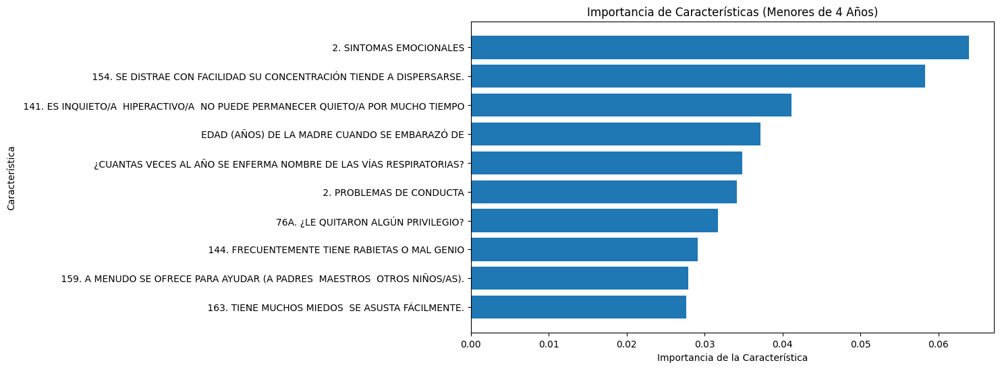

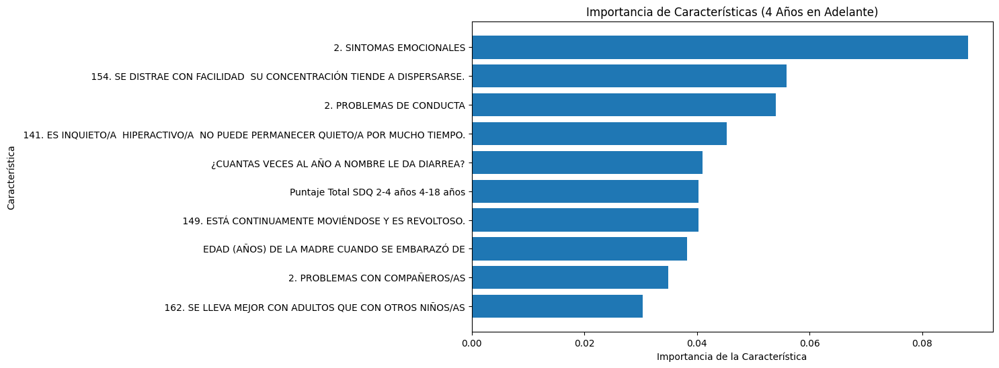

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Nombres de las características después de la codificación One-Hot y otros preprocesamientos
feature_names = np.array(X_train_m4.columns.tolist())

# Función para visualizar la importancia de las características
def plot_feature_importances(importances, feature_names, title):
    # Ordenar las importancias y sus índices
    indices = np.argsort(importances)[::-1]
    sorted_feature_names = feature_names[indices]

    # Seleccionar las 10 características más importantes
    top_indices = indices[:10]
    top_importances = importances[top_indices]
    top_feature_names = sorted_feature_names[:10]

    # Crear el gráfico
    plt.figure(figsize=(10, 6))
    plt.title(title)
    plt.barh(range(len(top_indices)), top_importances, align='center')
    plt.yticks(range(len(top_indices)), top_feature_names)
    plt.gca().invert_yaxis()  # Invertir el eje y para tener la característica más importante en la parte superior
    plt.xlabel('Importancia de la Característica')
    plt.ylabel('Característica')
    plt.show()

# Visualizar la importancia de las características para menores de 4 años
plot_feature_importances(feature_importances_m4, feature_names, "Importancia de Características (Menores de 4 Años)")

# Visualizar la importancia de las características para niños de 4 años en adelante
plot_feature_importances(feature_importances_4m, feature_names, "Importancia de Características (4 Años en Adelante)")

In [ ]:
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score

# Lista para almacenar los resultados de cada modelo
model_results = []

# Definir los modelos a entrenar
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Decision Tree": DecisionTreeClassifier(),
    "Support Vector Machine": SVC(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Entrenar y evaluar cada modelo
for name, model in models.items():
    # Ajustar el modelo al conjunto de entrenamiento para niños de 4 años en adelante (como ejemplo)
    model.fit(X_train_4m, y_train_4m)
    # Realizar predicciones en el conjunto de prueba
    predictions = model.predict(X_test_4m)
    # Calcular la precisión
    accuracy = accuracy_score(y_test_4m, predictions)
    # Calcular el reporte de clasificación que incluye precision, recall y f1-score
    report = classification_report(y_test_4m, predictions)
    # Almacenar los resultados
    model_results.append((name, accuracy, report))

# Ordenar los resultados por precisión de manera descendente
model_results.sort(key=lambda x: x[1], reverse=True)

# Mostrar los resultados
for name, accuracy, report in model_results:
    print(f"Model: {name}")
    print(f"Accuracy: {accuracy}")
    print(f"Classification Report:\n{report}\n")


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classif

Model: Logistic Regression
Accuracy: 0.6571428571428571
Classification Report:
              precision    recall  f1-score   support

           1       0.80      0.94      0.86        17
           2       0.50      0.56      0.53         9
           3       0.33      0.25      0.29         4
           4       0.50      0.20      0.29         5

    accuracy                           0.66        35
   macro avg       0.53      0.49      0.49        35
weighted avg       0.63      0.66      0.63        35


Model: Random Forest
Accuracy: 0.6
Classification Report:
              precision    recall  f1-score   support

           1       0.63      1.00      0.77        17
           2       0.50      0.33      0.40         9
           3       0.00      0.00      0.00         4
           4       0.50      0.20      0.29         5

    accuracy                           0.60        35
   macro avg       0.41      0.38      0.36        35
weighted avg       0.51      0.60      0.52    

In [ ]:
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score

# Lista para almacenar los resultados de cada modelo
model_results2 = []

# Definir los modelos a entrenar
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "Decision Tree": DecisionTreeClassifier(),
    "Support Vector Machine": SVC(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier()
}

# Entrenar y evaluar cada modelo
# Entrenar y evaluar cada modelo
for name, model in models.items():
    # Ajustar el modelo al conjunto de entrenamiento para niños de 4 años en adelante (como ejemplo)
    model.fit(X_train_m4, y_train_m4)
    # Realizar predicciones en el conjunto de prueba
    predictions = model.predict(X_test_m4)
    # Calcular la precisión
    accuracy = accuracy_score(y_test_m4, predictions)
    # Calcular el reporte de clasificación que incluye precision, recall y f1-score
    report = classification_report(y_test_m4, predictions)
    # Almacenar los resultados
    model_results2.append((name, accuracy, report))

# Ordenar los resultados por precisión de manera descendente
model_results2.sort(key=lambda x: x[1], reverse=True)

# Mostrar los resultados
for name, accuracy, report in model_results2:
    print(f"Model: {name}")
    print(f"Accuracy: {accuracy}")
    print(f"Classification Report:\n{report}\n")


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels wit

Model: Logistic Regression
Accuracy: 0.8666666666666667
Classification Report:
              precision    recall  f1-score   support

           1       0.89      1.00      0.94         8
           2       0.80      1.00      0.89         4
           3       0.00      0.00      0.00         1
           4       1.00      0.50      0.67         2

    accuracy                           0.87        15
   macro avg       0.67      0.62      0.62        15
weighted avg       0.82      0.87      0.83        15


Model: Random Forest
Accuracy: 0.6
Classification Report:
              precision    recall  f1-score   support

           1       0.57      1.00      0.73         8
           2       1.00      0.25      0.40         4
           3       0.00      0.00      0.00         1
           4       0.00      0.00      0.00         2

    accuracy                           0.60        15
   macro avg       0.39      0.31      0.28        15
weighted avg       0.57      0.60      0.49    

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

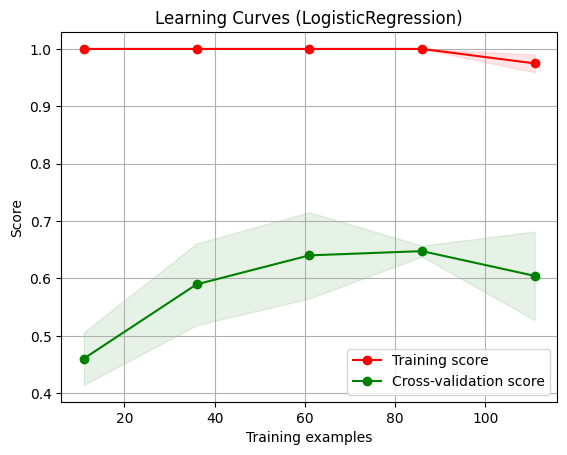

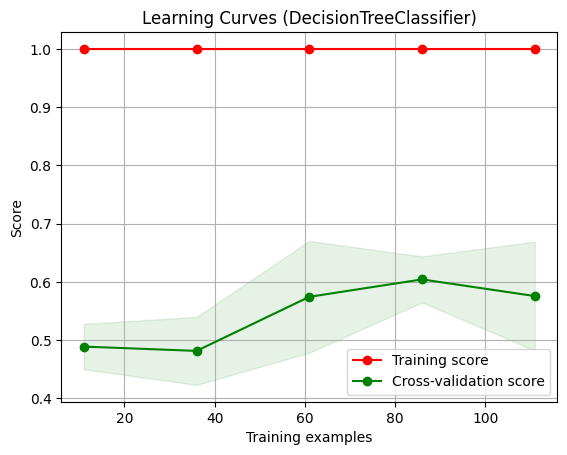

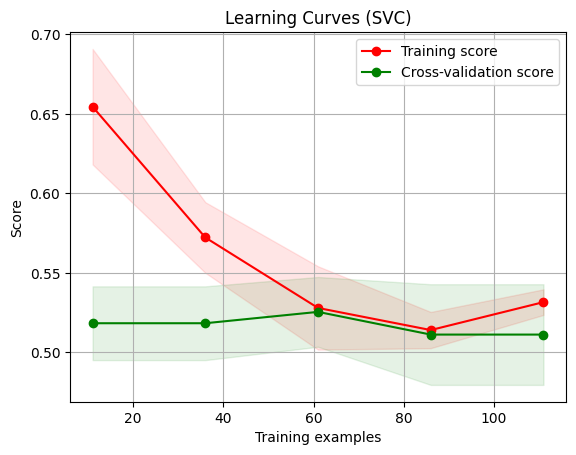

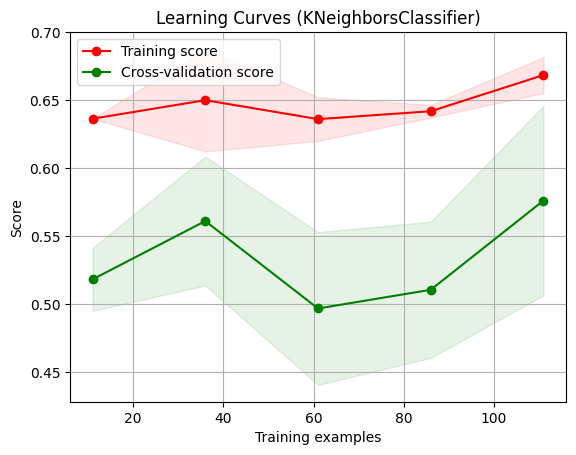

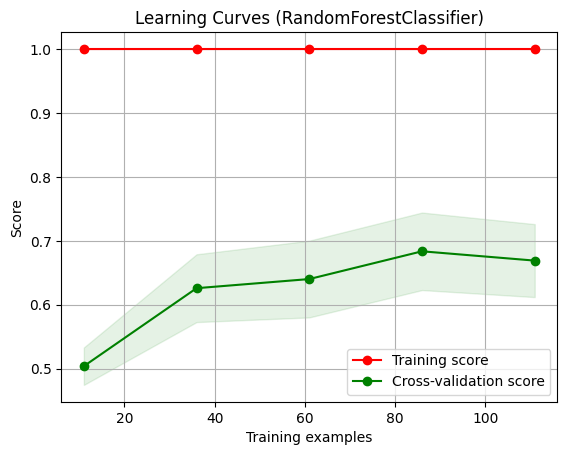

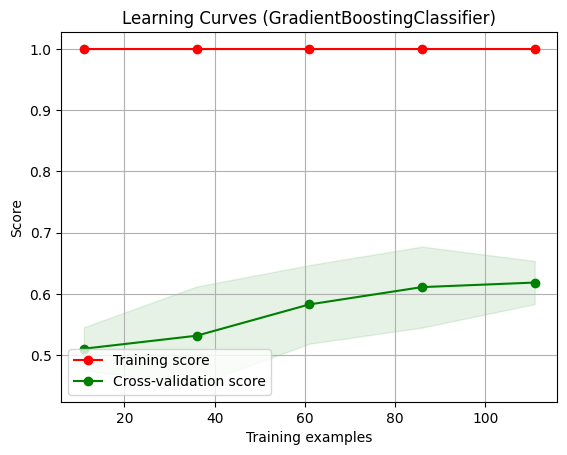

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import learning_curve

def plot_learning_curve(estimator, title, X, y, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    plt.figure()
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")

    plt.legend(loc="best")
    return plt

# Define the models you want to visualize
models_to_visualize = [LogisticRegression(max_iter=1000),
                       DecisionTreeClassifier(),
                       SVC(),
                       KNeighborsClassifier(),
                       RandomForestClassifier(),
                       GradientBoostingClassifier()]

# Plot learning curves for each model
for model in models_to_visualize:
    title = f"Learning Curves ({type(model).__name__})"
    plot_learning_curve(model, title, X_train_4m, y_train_4m, cv=5)
    plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _c

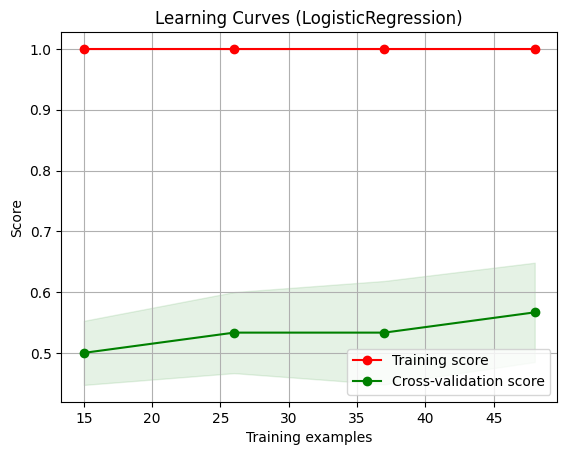

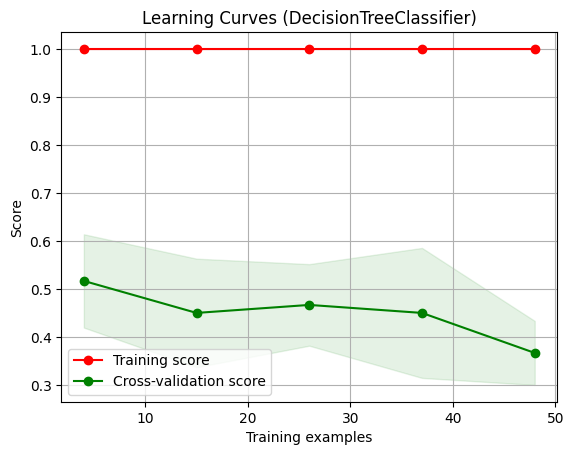

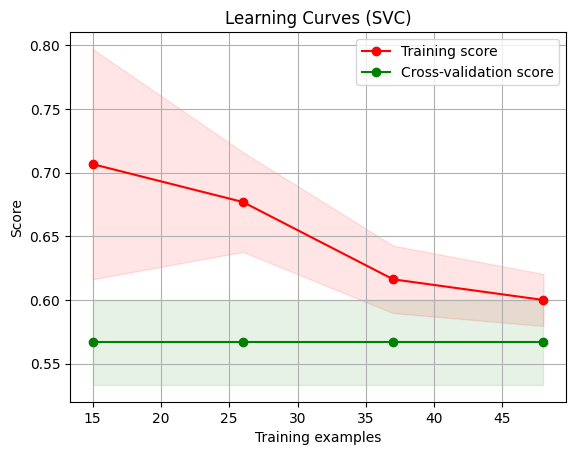

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:778: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_scorer.py", line 444, in _passthrough_scorer
    return estimator.score(*args, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 668, in score
    return accuracy_score(y, self.predict(X), sample_weight=sample_weight)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/neighbors/_classification.py", line 234, in predict
    neigh_ind = self.kneighbors(X, return_distance=False)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/neighbors/_base.py", line 810, in kneighbors
    raise ValueError(
Val

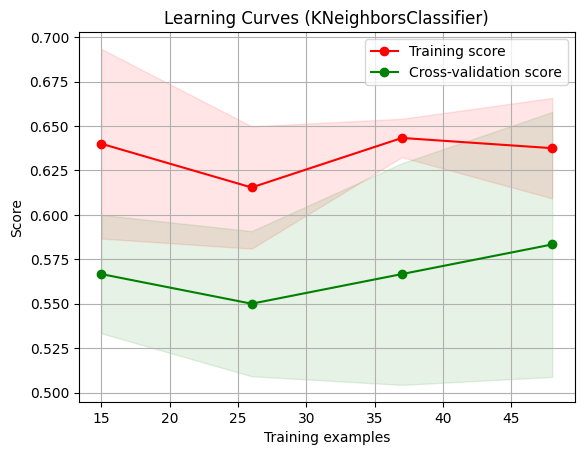

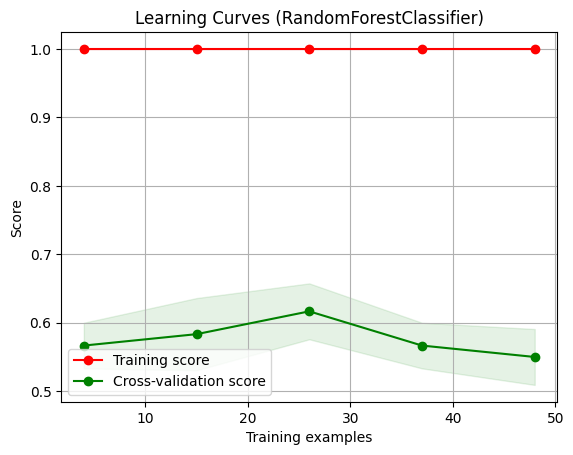

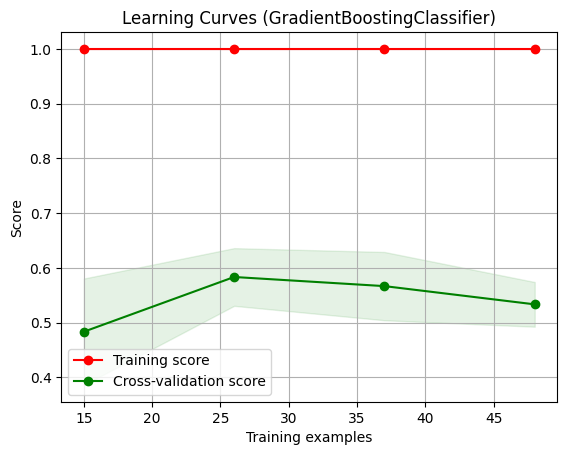

In [ ]:
# Define the models you want to visualize
models_to_visualize = [LogisticRegression(max_iter=1000),
                       DecisionTreeClassifier(),
                       SVC(),
                       KNeighborsClassifier(),
                       RandomForestClassifier(),
                       GradientBoostingClassifier()]

# Plot learning curves for each model
for model in models_to_visualize:
    title = f"Learning Curves ({type(model).__name__})"
    plot_learning_curve(model, title, X_train_m4, y_train_m4, cv=5)
    plt.show()


In [ ]:
# Seleccionar los dos mejores modelos
mejores_modelos = [LogisticRegression(), RandomForestClassifier()]

# Ajustar los dos mejores modelos
for modelo in mejores_modelos:
    modelo.fit(X_train_4m, y_train_4m)

# Evaluar el rendimiento de los modelos ajustados en los datos de prueba
for modelo in mejores_modelos:
    y_pred = modelo.predict(X_test_4m)
    accuracy = accuracy_score(y_test_4m, y_pred)
    print(f"Modelo: {type(modelo).__name__}, Precisión: {accuracy}")


Modelo: LogisticRegression, Precisión: 0.6285714285714286
Modelo: RandomForestClassifier, Precisión: 0.6285714285714286


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [ ]:
# Seleccionar los dos mejores modelos
mejores_modelosm4 = [LogisticRegression(), RandomForestClassifier()]

# Ajustar los dos mejores modelos
for modelo in mejores_modelosm4:
    modelo.fit(X_train_m4, y_train_m4)

# Evaluar el rendimiento de los modelos ajustados en los datos de prueba
for modelo in mejores_modelosm4:
    y_pred = modelo.predict(X_test_m4)
    accuracy = accuracy_score(y_test_m4, y_pred)
    print(f"Modelo: {type(modelo).__name__}, Precisión: {accuracy}")

Modelo: LogisticRegression, Precisión: 0.6666666666666666
Modelo: RandomForestClassifier, Precisión: 0.6


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [ ]:
# Seleccionar el modelo individual final
mejor_modelo = max(mejores_modelos, key=lambda modelo: accuracy_score(y_test_4m, modelo.predict(X_test_4m)))
print(f"El modelo final seleccionado es: {type(mejor_modelo).__name__}")


El modelo final seleccionado es: LogisticRegression


In [ ]:
# Seleccionar el modelo individual final
mejor_modelom4 = max(mejores_modelosm4, key=lambda modelo: accuracy_score(y_test_m4, modelo.predict(X_test_m4)))
print(f"El modelo final seleccionado es: {type(mejor_modelom4).__name__}")

El modelo final seleccionado es: LogisticRegression


**Referencias:**

Galli, S. (2022, October). *Python Feature Engineering Cookbook - Second Edition*. Packt Publishing.

Géron, A. (2022). *Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow, 3rd Edition*. O'Reilly Media, Inc.